<a href="https://colab.research.google.com/github/fedeu/Encrypt-Then-Compress-and-JPEG/blob/main/compressione_dati_(7).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Import librerie e specifiche path

In [ ]:
import PIL
from PIL import Image
import cv2
import numpy as np
import io
from google.colab.patches import cv2_imshow
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from math import log10, sqrt
import glob
import pandas as pd
import numpy as np

In [ ]:
path_image_resize = "/content/drive/MyDrive/Progetto Compressione/results/resize_image.png"
path_image_STD = "/content/drive/MyDrive/Progetto Compressione/jpeg/"
path_image_encoded = "/content/drive/MyDrive/Progetto Compressione/results/encoded_image.png"
path_image_compress = "/content/drive/MyDrive/Progetto Compressione/results/compress_encoded_image.jpg"
path_image_decompress = "/content/drive/MyDrive/Progetto Compressione/results/decompress_encoded_image.png"
path_image_decoded = "/content/drive/MyDrive/Progetto Compressione/results/decoded_image.jpg"
path_image_adv = "/content/drive/MyDrive/Progetto Compressione/results/adv_image.png"
path_image = "/content/drive/MyDrive/Progetto Compressione/img/"

#Metodo Encrypt-Then-Compress

In [ ]:
# Metodo Encrypt-Then-Compress
def etc(numpydata_image, name, qlt):
  #ottengo le dimensioni della matrice dell'immagine
  print(numpydata_image.shape)

  #salvataggio dell'immagine
  image = Image.fromarray(numpydata_image)
  image = image.convert('RGB')
  # aggiorno il path resize_image per aggiungere il nome della specifica immagine
  newpath_image_resize = path_image_resize.replace("resize_image.png", "resize_image_"+name)
  image.save(newpath_image_resize)
  

  #visualizzazione dell'immagine 
  print("Visualizzazione dell'immagine originale\n")
  img = mpimg.imread(newpath_image_resize)
  imgplot = plt.imshow(img)
  plt.show()

  #STD
  image.save(path_image_STD+name[:-4]+".jpg", optimize = True, quality = qlt)
  size_STD = os.path.getsize(path_image_STD+name[:-4]+".jpg")

  # cifratura
  A, C, path_component_yuv_encoded = encrypt(numpydata_image, name)

  # compressione
  path_component_compress = compress(path_component_yuv_encoded, name, qlt)

  # decompressione
  decompress(path_component_compress, name)

  # decifratura
  decrypt(A, C, name)

  # Calcolo del PSNR e del compression rate
  compression_rate = cr(path_component_yuv_encoded , path_component_compress)
  psnr_ETC = PSNR(path_component_yuv_encoded,path_component_compress)
  psnr_STD = PSNR(newpath_image_resize,path_image_STD+name[:-4]+".jpg")

  # Creo la lista con le informazioni dell'immagine: nome, Compression Rate, psnr_STD, psnr_ETC
  lst = [name, "{:.2f}".format(compression_rate),"{:.2f}".format(psnr_STD), "{:.2f}".format(psnr_ETC)]

  print("PSNR ETC value is "+ "{:.2f}".format(psnr_ETC) + " dB")
  print("PSNR STD value is "+ "{:.2f}".format(psnr_STD) + " dB")

  return A, lst

# Cifratura
Cifra l'immagine moltiplicando la matrice corrispondente per una matrice di cifratura ortogonale `C` generata col metodo `rvs()`. La matrice così ottenuta viene convertita in immagine in formato RGB e memorizzata.

In [ ]:
# Funzione per il calcolo della matrice C ortogonale
def rvs(dim=512): # dim è la dimensione dell'immagine n x n
     random_state = np.random # elementi scelti in maniera casuale
     H = np.eye(dim)
     D = np.ones((dim,))
     for n in range(1, dim):
         x = random_state.normal(size=(dim-n+1,))
         D[n-1] = np.sign(x[0])
         x[0] -= D[n-1]*np.sqrt((x*x).sum())
         # Householder transformation
         Hx = (np.eye(dim-n+1) - 2.*np.outer(x, x)/(x*x).sum())
         mat = np.eye(dim)
         mat[n-1:, n-1:] = Hx
         H = np.dot(H, mat)
         # Sistema l'ultimo segno affinché il determinante sia = 1
     D[-1] = (-1)**(1-(dim % 2))*D.prod()
     # Prodotto equivalente a np.dot(np.diag(D), H)
     H = (D*H.T).T
     return H

# Cifratura
def encrypt(numpydata_image, name):
  # salvataggio matrice di cifratura come array numpy
  C = rvs()
  # Prodotto tra la matrice di cifratura e la matrice dell'immagine
  A = numpydata_image @ C

  # Conversione matrice cifrata in immagine RGB
  image_encoded = Image.fromarray(A)
  image_encoded = image_encoded.convert('RGB')

  # Calcolo del path dove salvare l'immagine codificata
  newpath_encoded_yuv = path_image_encoded.replace("encoded_image.png", "encoded_image_"+name)

  image_encoded.save(newpath_encoded_yuv)

  # Step opzionale del paper: troncamento e arrotondamento a intera della matrice A
  A = A.astype(int)

  #visualizzazione immagine criptata
  print("Visualizzazione dell'immagine criptata\n")
  img = mpimg.imread(newpath_encoded_yuv)
  imgplot = plt.imshow(img)
  plt.show()
  return A, C, newpath_encoded_yuv

# Compressione
Salva l'immagine cifrata in formato JPEG

In [ ]:
#compressione dell'immagine criptata con JPEG
def compress(path_component_yuv_encoded, name, qlt):

  image_encoded = Image.open(path_component_yuv_encoded)
  compress_image = image_encoded.convert("RGB")

  # Calcolo del path da assegnare all'immagine cifrata e compressa
  newpath_compress = path_image_compress.replace("compress_encoded_image.jpg", "compress_encoded_image_"+name[:-4]+".jpg")
  compress_image.save(newpath_compress, optimize = True, quality = qlt)

  return newpath_compress

# Decompressione
Salva l'immagine cifrata usando il formato dell'immagine di partenza

In [ ]:
#Decompressione dell'immagine criptata
def decompress(path_component_compress, name):
  image_decompress = Image.open(path_component_compress)

  # Calcolo del path da assegnare all'immagine cifrata e decompressa
  newpath_decompress = path_image_decompress.replace("decompress_encoded_image.png", "decompress_encoded_image_"+name)
  image_decompress.save(newpath_decompress)

  #print("\nSize immagine decriptata e decompressa: ", os.path.getsize(newpath_decompress),"kb")

# Decifratura
Moltiplica la matrice `A`, corrispondente all'immagine cifrata, per l'inversa della matrice di cifratura `C`. Converte l'immagine decifrata in RGB e la memorizza.

In [ ]:
def decrypt(A, C, name):
  #calcolo della matrice C inversa, essendo la matrice ortogonale l'inversa coincide con la trasposta
  Inv = np.linalg.inv(C)

  #ritorno all'immagine iniziale
  originale = A @ Inv

  image_decoded = Image.fromarray(originale)
  image_decoded = image_decoded.convert('RGB')

  # Calcolo del path da assegnare all'immagine decifrata e decompressa
  newpath_decoded = path_image_decoded.replace("decoded_image.jpg","decoded_image_"+name)
  image_decoded.save(newpath_decoded)

  #visualizzazione dell'immagine originale
  print("Visualizzazione dell'immagine decompressa e decriptata\n")
  img = mpimg.imread(newpath_decoded)
  imgplot = plt.imshow(img)
  plt.show()

# Compression rate e PSNR

In [ ]:
#Calcolo del Compression Rate: uncompressed size / compressed size
def cr(uncompressed_path, compressed_path):
  compression_rate = os.path.getsize(uncompressed_path) / os.path.getsize(compressed_path)
  print("Compressione Rate (size img iniziale/ size img compressa compressa): " + "{:.2f}".format(compression_rate))
  return compression_rate
  
# Maggiore è il valore del PSNR maggiore è la "somiglianza" con l'immagine originale, nel senso che si "avvicina" maggiormente ad essa da un punto di vista percettivo umano.
def PSNR(encoded_path, encoded_compressed_path):
  original = cv2.imread(encoded_path) #immagine criptata
  compressed = cv2.imread(encoded_compressed_path, 1) #immagine criptata compressa

  mse = np.mean((original - compressed) ** 2)
  if(mse == 0): # MSE è uguale a 0 se non c'è rumore nell'immagine
    # In tal caso il PSNR non è rilevante
    return 100
  max_pixel = 255.0
  psnr = 20 * log10(max_pixel / sqrt(mse))
  return psnr


# Prova attaccante

In [ ]:
#Prova decifratura utilizzando una matrice diversa da quella usata per cifrare 
def provaAttaccante(A):
  new_matrix = rvs()

  #calcolo della matrice inversa
  new_matrix_Inv = np.linalg.inv(new_matrix)

  #ritorno all'immagine iniziale Adv
  fake = A @ new_matrix_Inv

  image_fake = Image.fromarray(fake)
  image_fake = image_fake.convert('RGB')
  image_fake.save(path_image_adv)

  #visualizzazione dell'immagine originale
  print("Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:\n")
  img = mpimg.imread(path_image_adv)
  imgplot = plt.imshow(img)
  plt.show()

# Data preparation
Si prende ogni immagine nella cartella specificata a `path_image`, la si converte da RGB a YUV e si applica a ciascuna componente Y, U, V di ciascuna immagine lo schema Encrypt-Then-Compress, implementato nella funzione `etc()`



Qualità dell'immagine 10%

*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



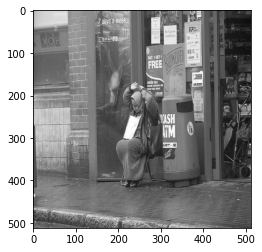

Visualizzazione dell'immagine criptata



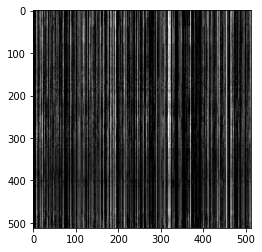

Visualizzazione dell'immagine decompressa e decriptata



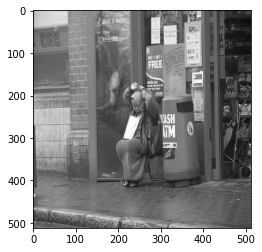

Compressione Rate (size img iniziale/ size img compressa compressa): 11.45
PSNR ETC value is 30.22 dB
PSNR STD value is 30.85 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



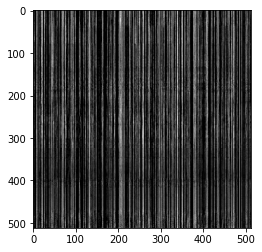


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



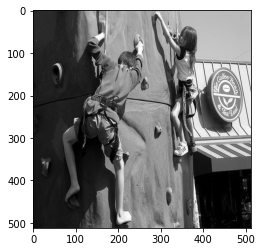

Visualizzazione dell'immagine criptata



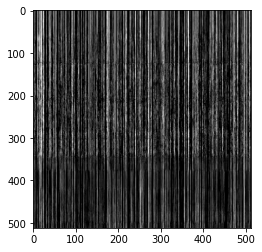

Visualizzazione dell'immagine decompressa e decriptata



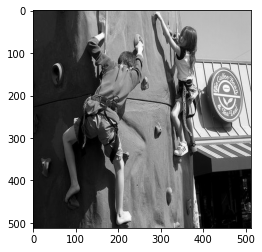

Compressione Rate (size img iniziale/ size img compressa compressa): 10.60
PSNR ETC value is 29.97 dB
PSNR STD value is 31.69 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



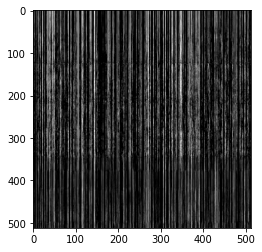


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



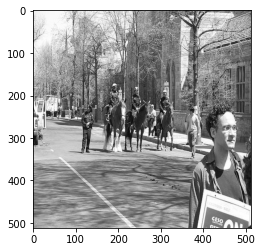

Visualizzazione dell'immagine criptata



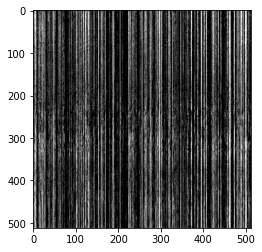

Visualizzazione dell'immagine decompressa e decriptata



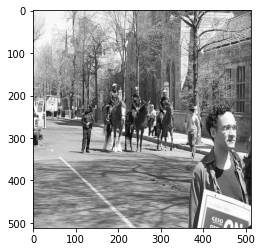

Compressione Rate (size img iniziale/ size img compressa compressa): 11.59
PSNR ETC value is 29.79 dB
PSNR STD value is 29.36 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



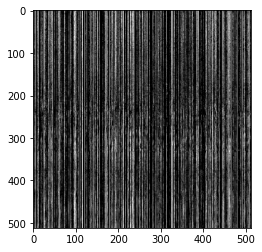


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



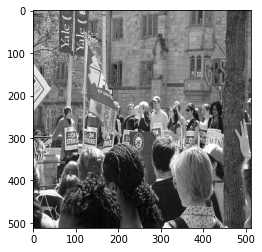

Visualizzazione dell'immagine criptata



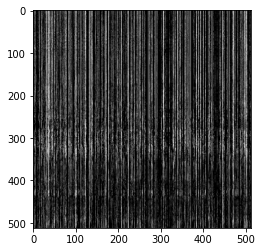

Visualizzazione dell'immagine decompressa e decriptata



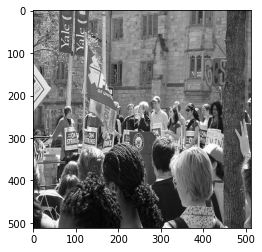

Compressione Rate (size img iniziale/ size img compressa compressa): 12.07
PSNR ETC value is 29.74 dB
PSNR STD value is 29.61 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



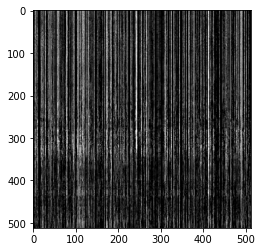


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



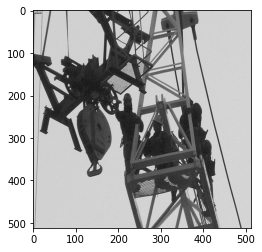

Visualizzazione dell'immagine criptata



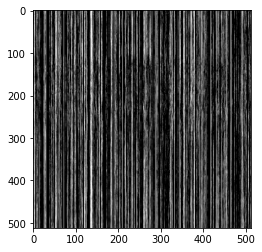

Visualizzazione dell'immagine decompressa e decriptata



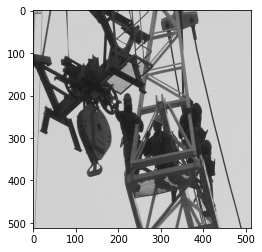

Compressione Rate (size img iniziale/ size img compressa compressa): 9.28
PSNR ETC value is 30.16 dB
PSNR STD value is 31.62 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



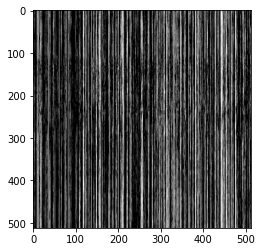


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



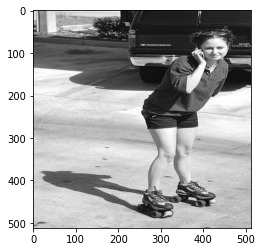

Visualizzazione dell'immagine criptata



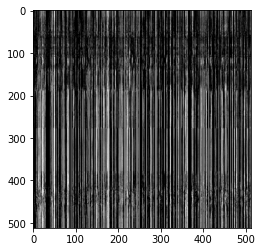

Visualizzazione dell'immagine decompressa e decriptata



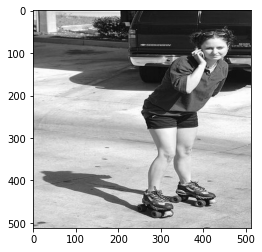

Compressione Rate (size img iniziale/ size img compressa compressa): 9.83
PSNR ETC value is 30.22 dB
PSNR STD value is 31.48 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



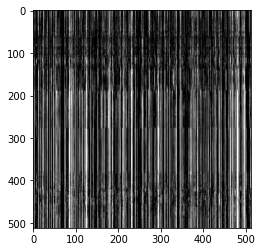


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



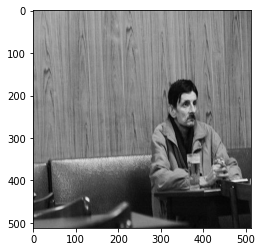

Visualizzazione dell'immagine criptata



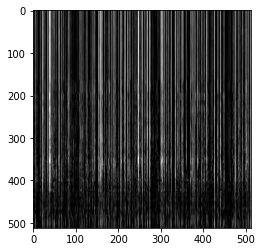

Visualizzazione dell'immagine decompressa e decriptata



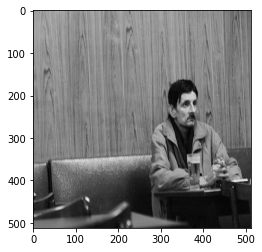

Compressione Rate (size img iniziale/ size img compressa compressa): 8.84
PSNR ETC value is 30.37 dB
PSNR STD value is 31.66 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



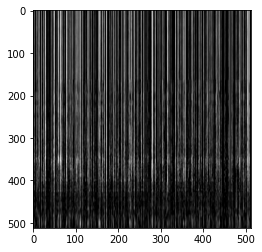


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



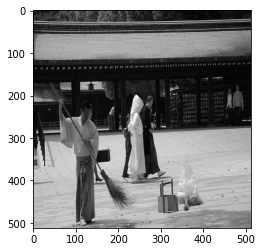

Visualizzazione dell'immagine criptata



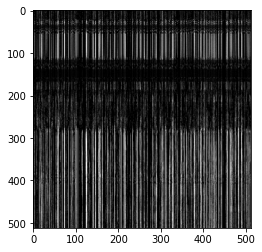

Visualizzazione dell'immagine decompressa e decriptata



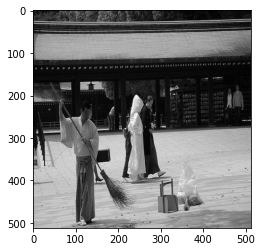

Compressione Rate (size img iniziale/ size img compressa compressa): 11.80
PSNR ETC value is 30.19 dB
PSNR STD value is 30.87 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



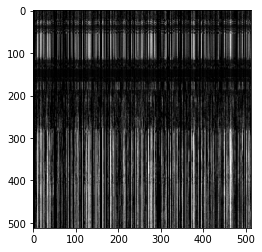


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



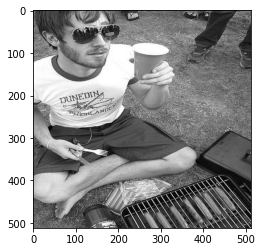

Visualizzazione dell'immagine criptata



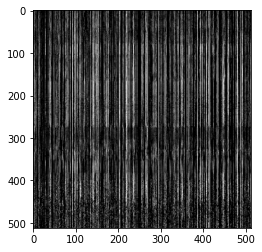

Visualizzazione dell'immagine decompressa e decriptata



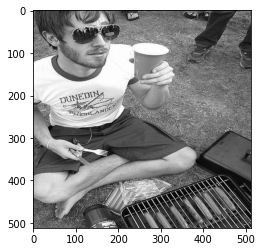

Compressione Rate (size img iniziale/ size img compressa compressa): 12.24
PSNR ETC value is 29.84 dB
PSNR STD value is 29.92 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



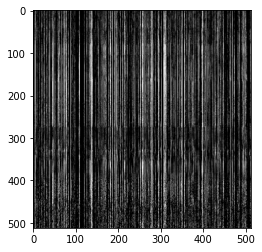


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



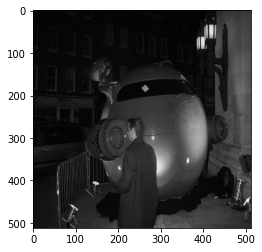

Visualizzazione dell'immagine criptata



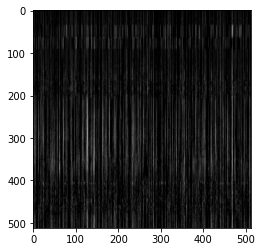

Visualizzazione dell'immagine decompressa e decriptata



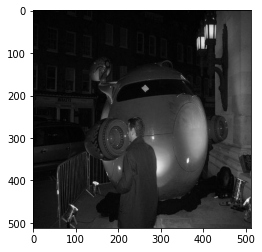

Compressione Rate (size img iniziale/ size img compressa compressa): 16.06
PSNR ETC value is 30.23 dB
PSNR STD value is 33.82 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



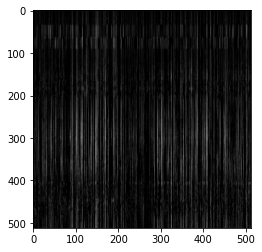


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



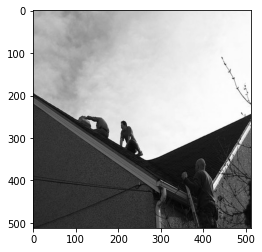

Visualizzazione dell'immagine criptata



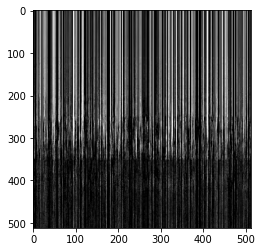

Visualizzazione dell'immagine decompressa e decriptata



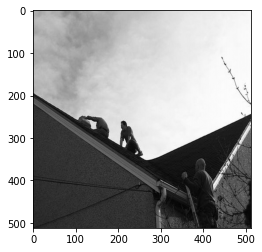

Compressione Rate (size img iniziale/ size img compressa compressa): 8.93
PSNR ETC value is 30.29 dB
PSNR STD value is 33.47 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



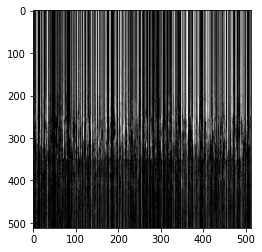


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



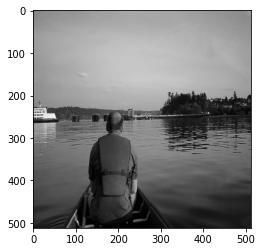

Visualizzazione dell'immagine criptata



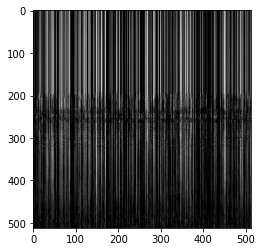

Visualizzazione dell'immagine decompressa e decriptata



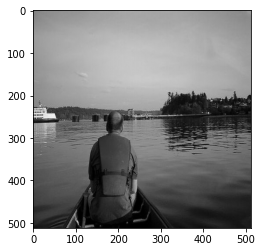

Compressione Rate (size img iniziale/ size img compressa compressa): 9.26
PSNR ETC value is 30.23 dB
PSNR STD value is 33.85 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



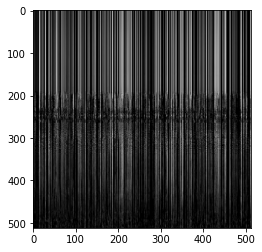


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



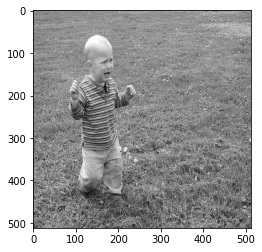

Visualizzazione dell'immagine criptata



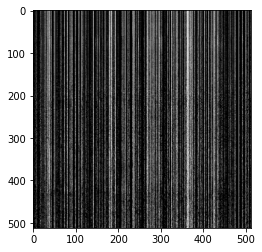

Visualizzazione dell'immagine decompressa e decriptata



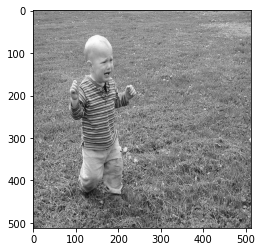

Compressione Rate (size img iniziale/ size img compressa compressa): 12.07
PSNR ETC value is 29.84 dB
PSNR STD value is 28.77 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



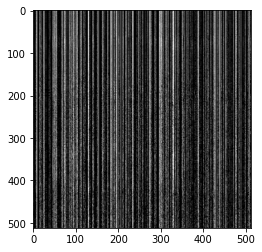


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



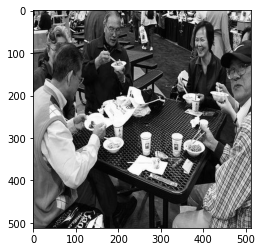

Visualizzazione dell'immagine criptata



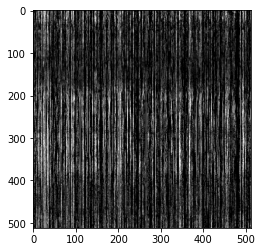

Visualizzazione dell'immagine decompressa e decriptata



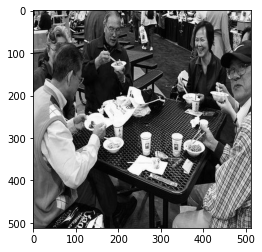

Compressione Rate (size img iniziale/ size img compressa compressa): 12.15
PSNR ETC value is 29.67 dB
PSNR STD value is 30.16 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



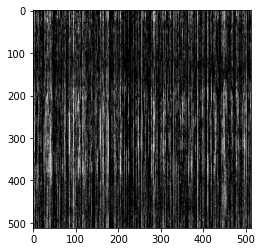


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



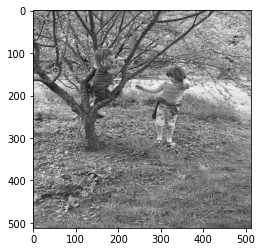

Visualizzazione dell'immagine criptata



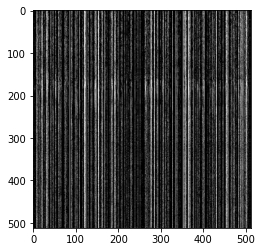

Visualizzazione dell'immagine decompressa e decriptata



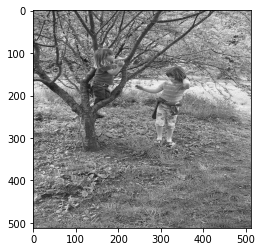

Compressione Rate (size img iniziale/ size img compressa compressa): 13.43
PSNR ETC value is 29.73 dB
PSNR STD value is 28.54 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



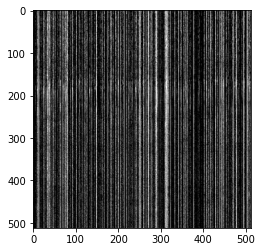


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



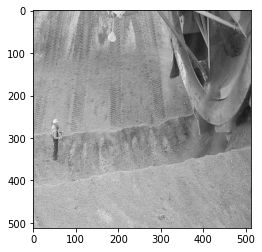

Visualizzazione dell'immagine criptata



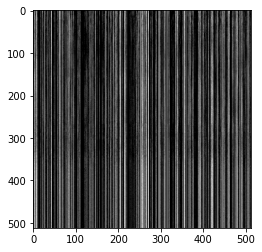

Visualizzazione dell'immagine decompressa e decriptata



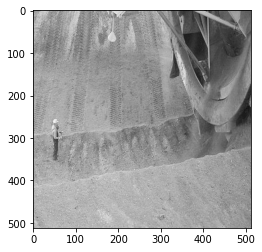

Compressione Rate (size img iniziale/ size img compressa compressa): 10.02
PSNR ETC value is 30.24 dB
PSNR STD value is 30.55 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



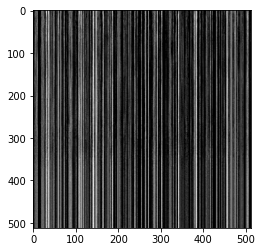


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



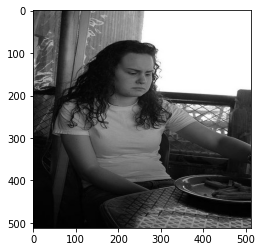

Visualizzazione dell'immagine criptata



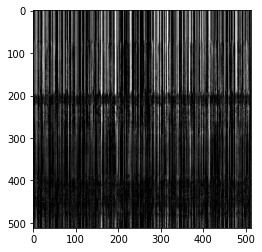

Visualizzazione dell'immagine decompressa e decriptata



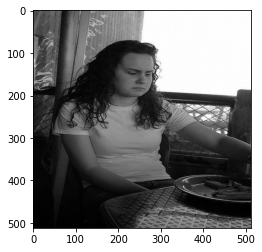

Compressione Rate (size img iniziale/ size img compressa compressa): 12.67
PSNR ETC value is 30.15 dB
PSNR STD value is 32.50 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



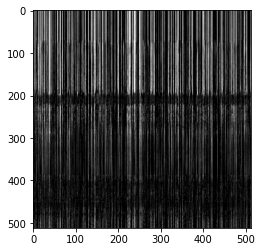


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



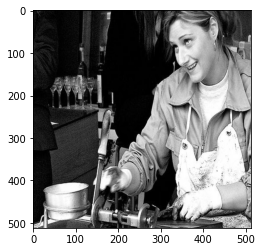

Visualizzazione dell'immagine criptata



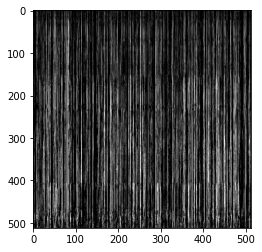

Visualizzazione dell'immagine decompressa e decriptata



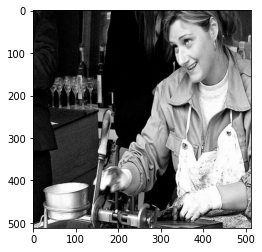

Compressione Rate (size img iniziale/ size img compressa compressa): 10.75
PSNR ETC value is 29.97 dB
PSNR STD value is 31.20 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



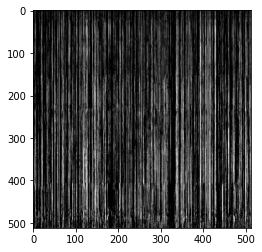


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



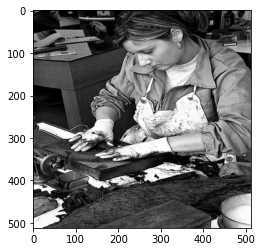

Visualizzazione dell'immagine criptata



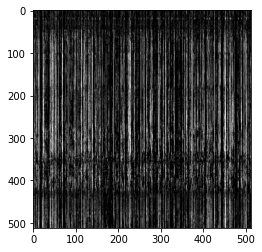

Visualizzazione dell'immagine decompressa e decriptata



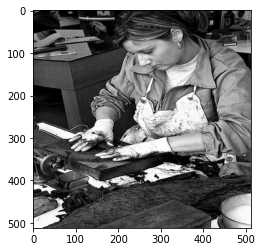

Compressione Rate (size img iniziale/ size img compressa compressa): 13.04
PSNR ETC value is 29.71 dB
PSNR STD value is 30.01 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



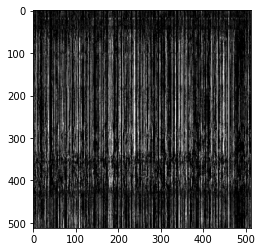


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



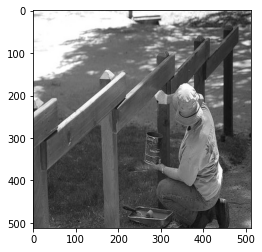

Visualizzazione dell'immagine criptata



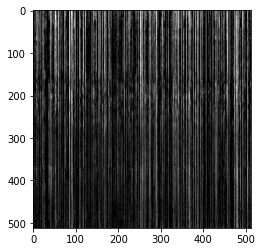

Visualizzazione dell'immagine decompressa e decriptata



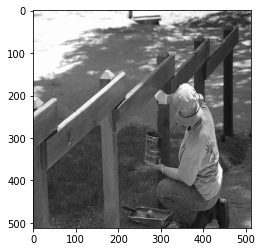

Compressione Rate (size img iniziale/ size img compressa compressa): 10.96
PSNR ETC value is 30.07 dB
PSNR STD value is 31.80 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



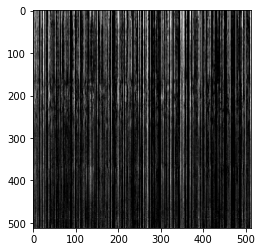


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



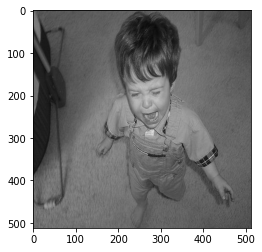

Visualizzazione dell'immagine criptata



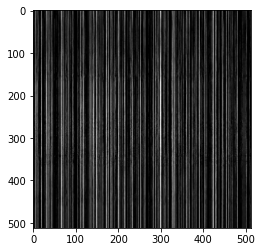

Visualizzazione dell'immagine decompressa e decriptata



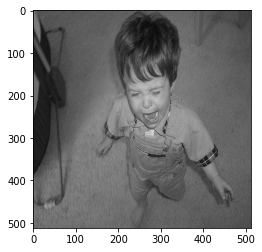

Compressione Rate (size img iniziale/ size img compressa compressa): 10.38
PSNR ETC value is 30.37 dB
PSNR STD value is 32.92 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



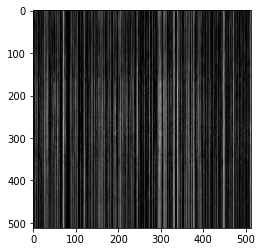


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



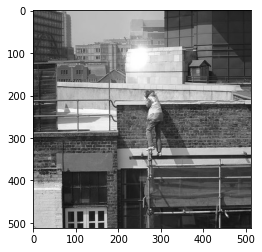

Visualizzazione dell'immagine criptata



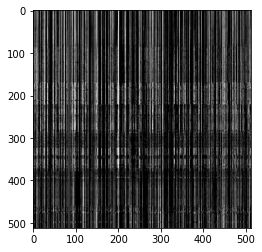

Visualizzazione dell'immagine decompressa e decriptata



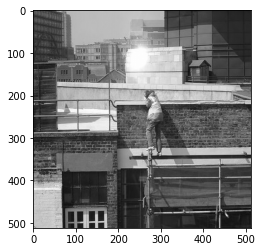

Compressione Rate (size img iniziale/ size img compressa compressa): 11.25
PSNR ETC value is 30.02 dB
PSNR STD value is 30.82 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



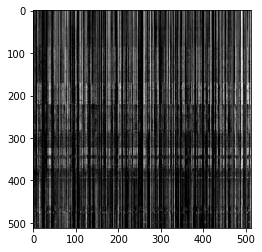


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



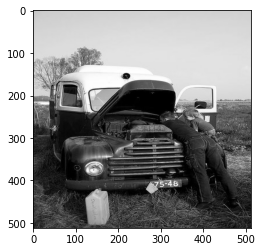

Visualizzazione dell'immagine criptata



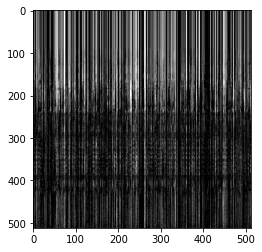

Visualizzazione dell'immagine decompressa e decriptata



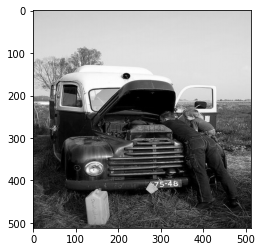

Compressione Rate (size img iniziale/ size img compressa compressa): 11.97
PSNR ETC value is 29.91 dB
PSNR STD value is 31.28 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



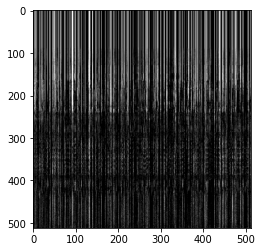


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



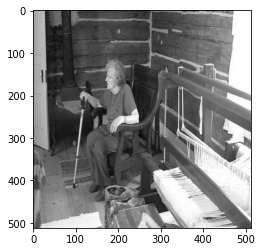

Visualizzazione dell'immagine criptata



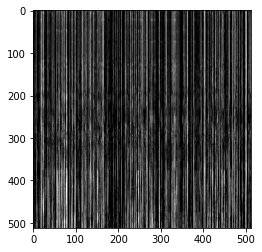

Visualizzazione dell'immagine decompressa e decriptata



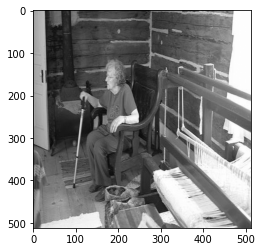

Compressione Rate (size img iniziale/ size img compressa compressa): 9.89
PSNR ETC value is 30.19 dB
PSNR STD value is 31.83 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



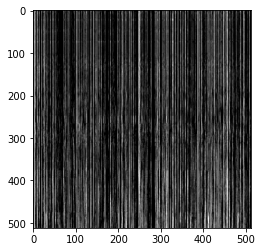


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



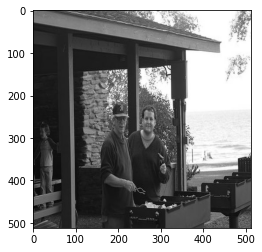

Visualizzazione dell'immagine criptata



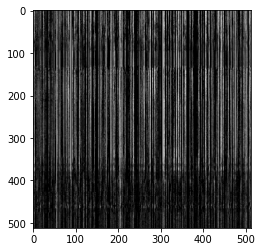

Visualizzazione dell'immagine decompressa e decriptata



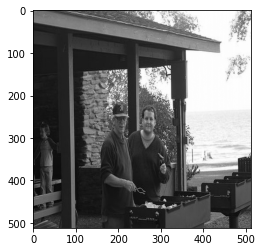

Compressione Rate (size img iniziale/ size img compressa compressa): 11.13
PSNR ETC value is 30.13 dB
PSNR STD value is 31.95 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



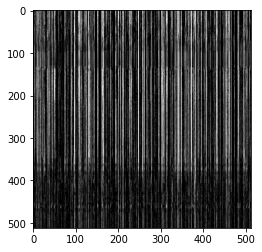


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



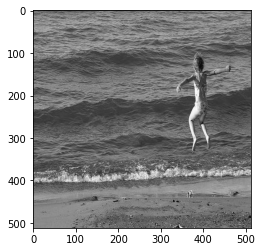

Visualizzazione dell'immagine criptata



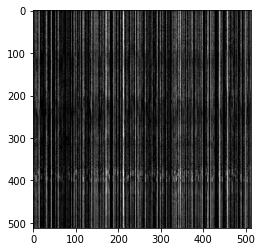

Visualizzazione dell'immagine decompressa e decriptata



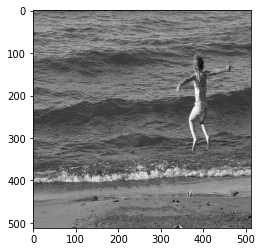

Compressione Rate (size img iniziale/ size img compressa compressa): 12.50
PSNR ETC value is 29.94 dB
PSNR STD value is 30.11 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



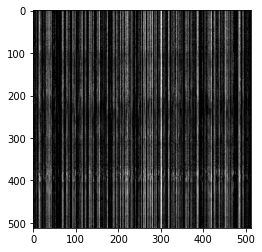


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



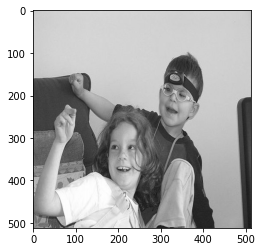

Visualizzazione dell'immagine criptata



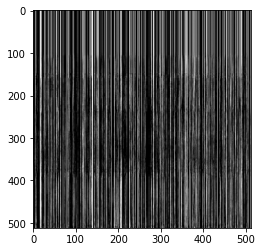

Visualizzazione dell'immagine decompressa e decriptata



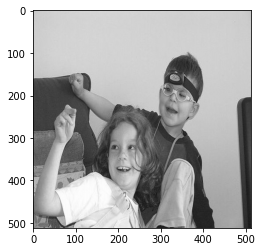

Compressione Rate (size img iniziale/ size img compressa compressa): 7.77
PSNR ETC value is 30.38 dB
PSNR STD value is 33.31 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



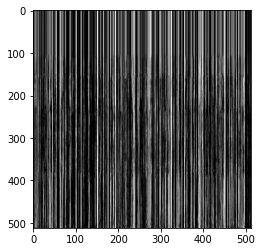


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



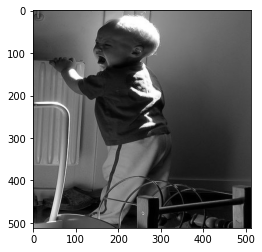

Visualizzazione dell'immagine criptata



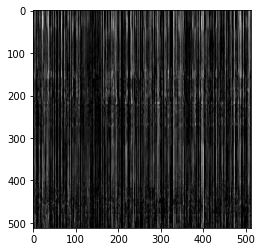

Visualizzazione dell'immagine decompressa e decriptata



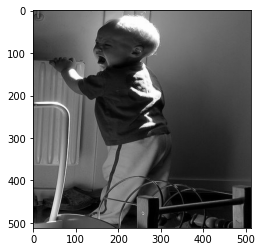

Compressione Rate (size img iniziale/ size img compressa compressa): 11.59
PSNR ETC value is 30.16 dB
PSNR STD value is 33.56 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



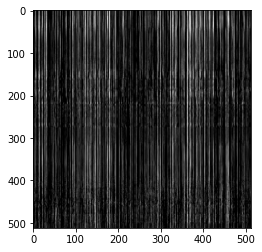


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



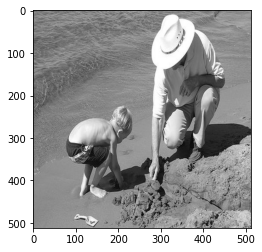

Visualizzazione dell'immagine criptata



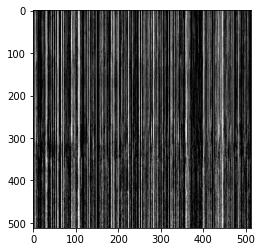

Visualizzazione dell'immagine decompressa e decriptata



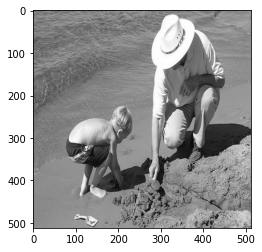

Compressione Rate (size img iniziale/ size img compressa compressa): 10.29
PSNR ETC value is 30.00 dB
PSNR STD value is 30.90 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



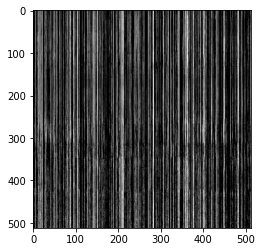


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



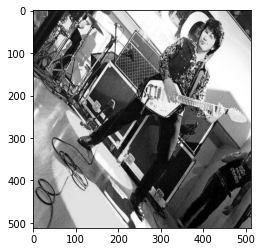

Visualizzazione dell'immagine criptata



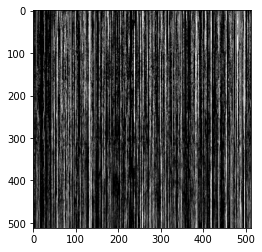

Visualizzazione dell'immagine decompressa e decriptata



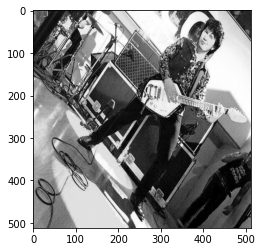

Compressione Rate (size img iniziale/ size img compressa compressa): 10.55
PSNR ETC value is 29.87 dB
PSNR STD value is 30.42 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



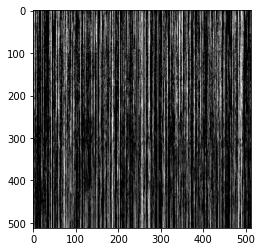


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



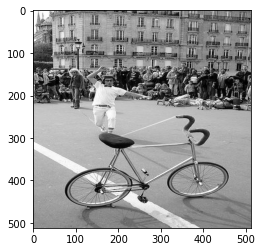

Visualizzazione dell'immagine criptata



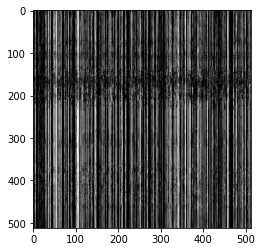

Visualizzazione dell'immagine decompressa e decriptata



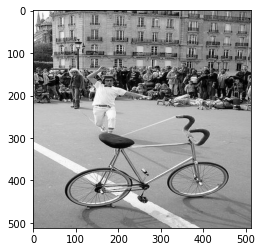

Compressione Rate (size img iniziale/ size img compressa compressa): 11.39
PSNR ETC value is 29.83 dB
PSNR STD value is 30.41 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



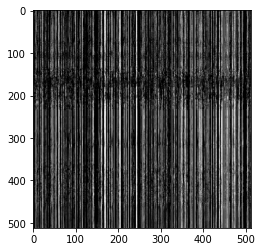


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



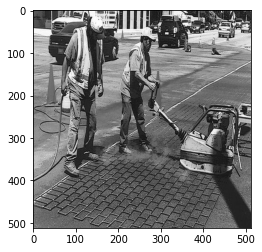

Visualizzazione dell'immagine criptata



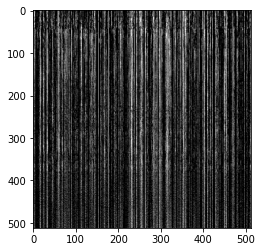

Visualizzazione dell'immagine decompressa e decriptata



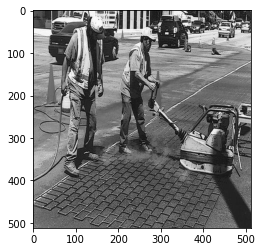

Compressione Rate (size img iniziale/ size img compressa compressa): 12.39
PSNR ETC value is 29.67 dB
PSNR STD value is 29.41 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



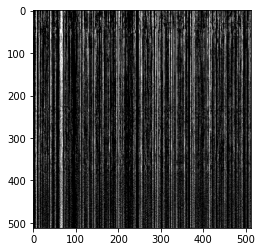


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



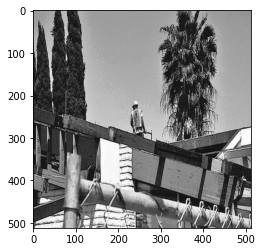

Visualizzazione dell'immagine criptata



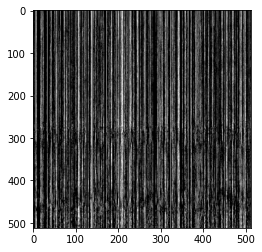

Visualizzazione dell'immagine decompressa e decriptata



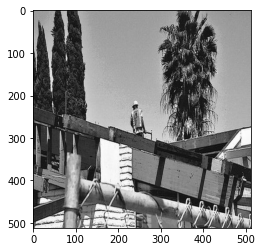

Compressione Rate (size img iniziale/ size img compressa compressa): 10.62
PSNR ETC value is 29.85 dB
PSNR STD value is 30.62 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



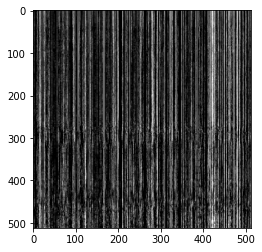


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



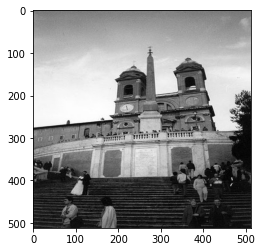

Visualizzazione dell'immagine criptata



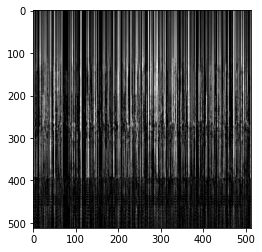

Visualizzazione dell'immagine decompressa e decriptata



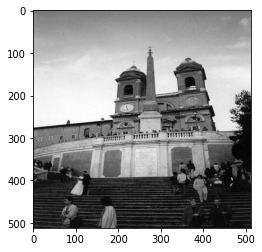

Compressione Rate (size img iniziale/ size img compressa compressa): 11.31
PSNR ETC value is 29.96 dB
PSNR STD value is 31.64 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



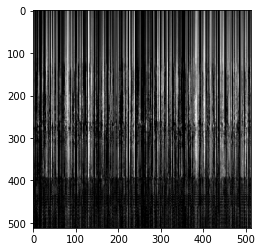


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



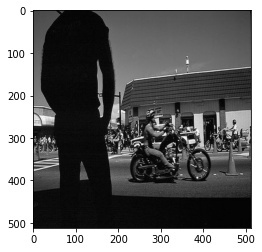

Visualizzazione dell'immagine criptata



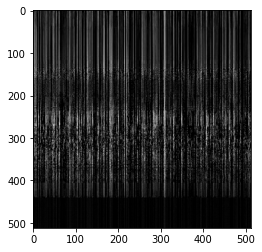

Visualizzazione dell'immagine decompressa e decriptata



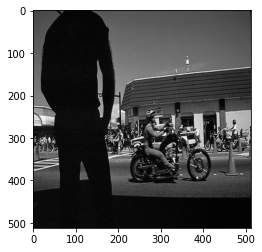

Compressione Rate (size img iniziale/ size img compressa compressa): 13.59
PSNR ETC value is 30.19 dB
PSNR STD value is 32.64 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



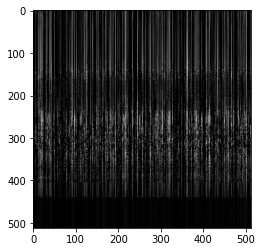


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



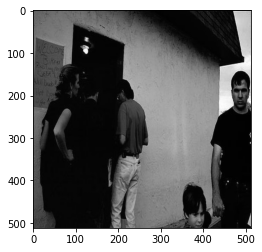

Visualizzazione dell'immagine criptata



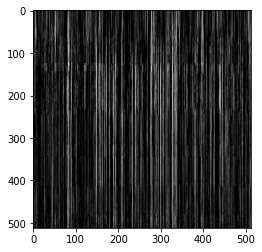

Visualizzazione dell'immagine decompressa e decriptata



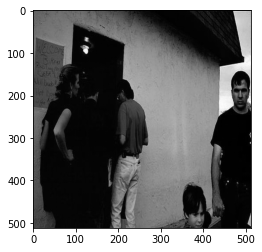

Compressione Rate (size img iniziale/ size img compressa compressa): 10.51
PSNR ETC value is 30.27 dB
PSNR STD value is 33.67 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



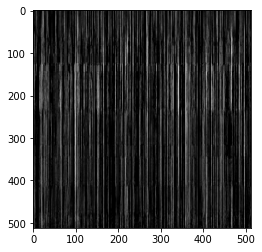


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



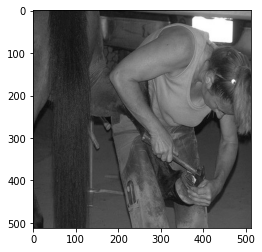

Visualizzazione dell'immagine criptata



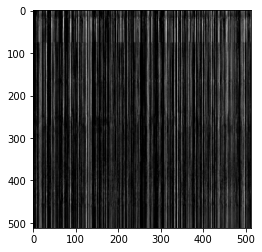

Visualizzazione dell'immagine decompressa e decriptata



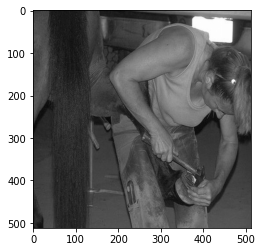

Compressione Rate (size img iniziale/ size img compressa compressa): 10.81
PSNR ETC value is 30.31 dB
PSNR STD value is 32.50 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



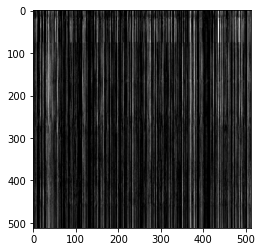


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



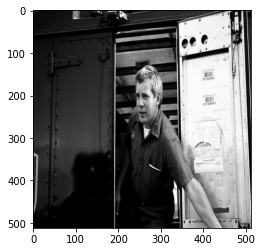

Visualizzazione dell'immagine criptata



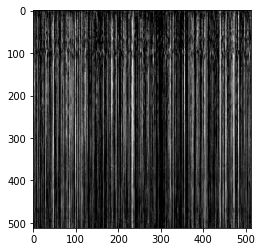

Visualizzazione dell'immagine decompressa e decriptata



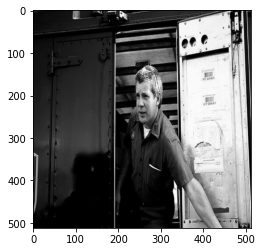

Compressione Rate (size img iniziale/ size img compressa compressa): 10.53
PSNR ETC value is 29.97 dB
PSNR STD value is 32.38 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



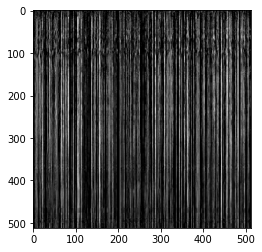


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



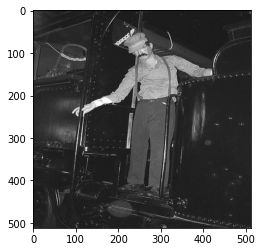

Visualizzazione dell'immagine criptata



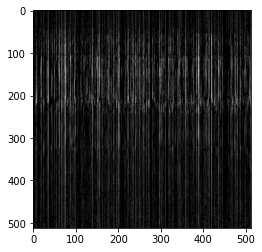

Visualizzazione dell'immagine decompressa e decriptata



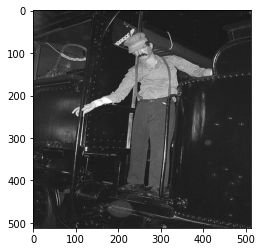

Compressione Rate (size img iniziale/ size img compressa compressa): 17.38
PSNR ETC value is 30.07 dB
PSNR STD value is 32.39 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



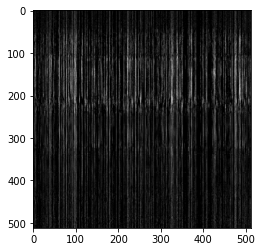


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



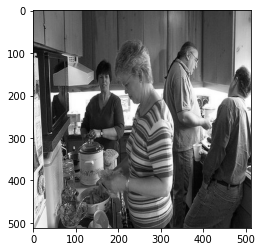

Visualizzazione dell'immagine criptata



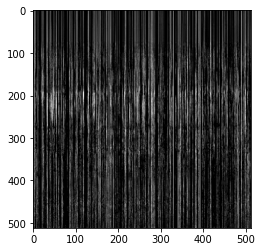

Visualizzazione dell'immagine decompressa e decriptata



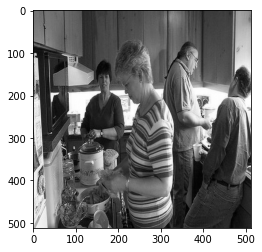

Compressione Rate (size img iniziale/ size img compressa compressa): 10.89
PSNR ETC value is 30.13 dB
PSNR STD value is 30.97 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



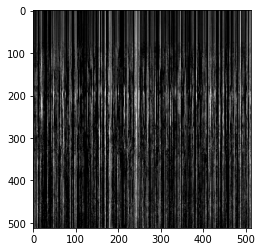


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



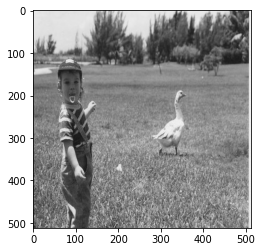

Visualizzazione dell'immagine criptata



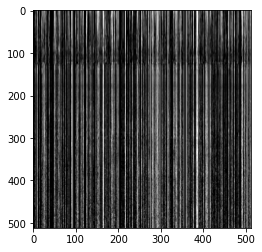

Visualizzazione dell'immagine decompressa e decriptata



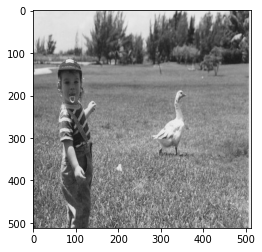

Compressione Rate (size img iniziale/ size img compressa compressa): 9.71
PSNR ETC value is 30.17 dB
PSNR STD value is 30.61 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



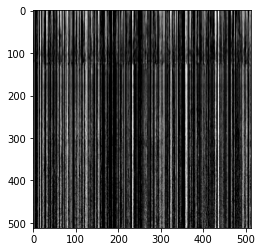


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



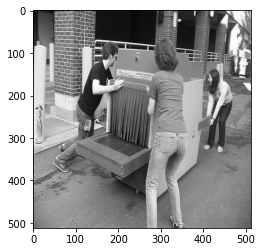

Visualizzazione dell'immagine criptata



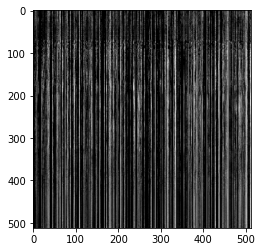

Visualizzazione dell'immagine decompressa e decriptata



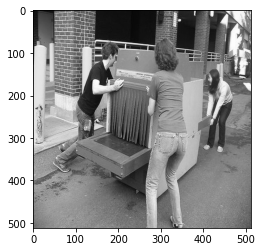

Compressione Rate (size img iniziale/ size img compressa compressa): 10.82
PSNR ETC value is 30.11 dB
PSNR STD value is 30.75 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



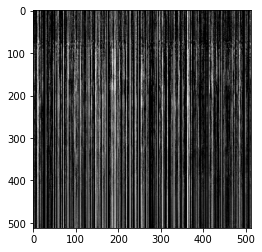


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



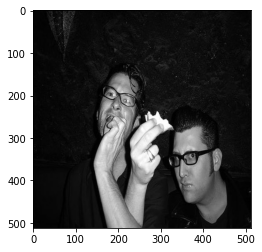

Visualizzazione dell'immagine criptata



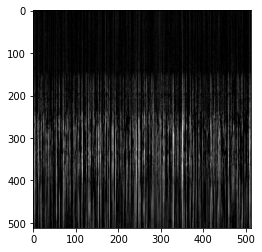

Visualizzazione dell'immagine decompressa e decriptata



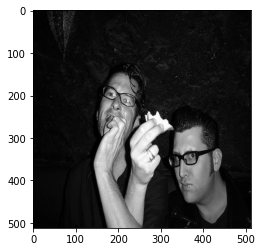

Compressione Rate (size img iniziale/ size img compressa compressa): 14.11
PSNR ETC value is 30.57 dB
PSNR STD value is 33.32 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



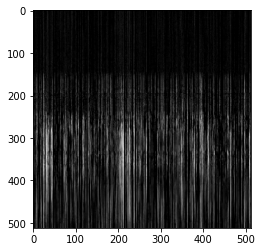


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



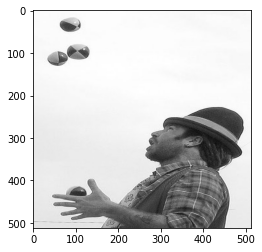

Visualizzazione dell'immagine criptata



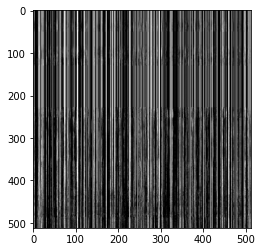

Visualizzazione dell'immagine decompressa e decriptata



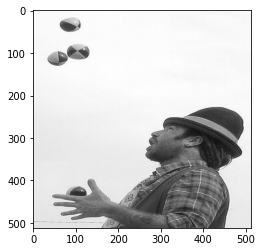

Compressione Rate (size img iniziale/ size img compressa compressa): 7.13
PSNR ETC value is 30.52 dB
PSNR STD value is 34.21 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



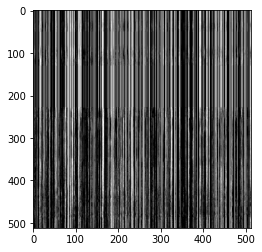


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



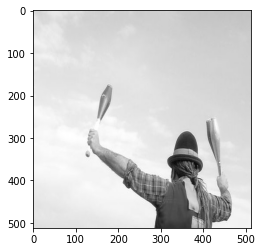

Visualizzazione dell'immagine criptata



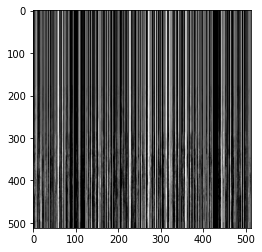

Visualizzazione dell'immagine decompressa e decriptata



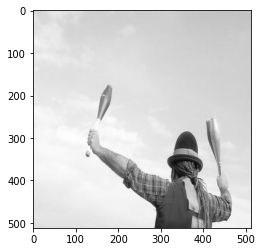

Compressione Rate (size img iniziale/ size img compressa compressa): 5.57
PSNR ETC value is 30.78 dB
PSNR STD value is 35.70 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



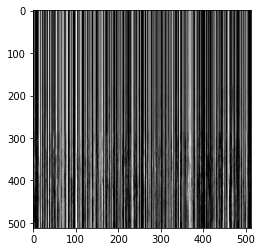


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



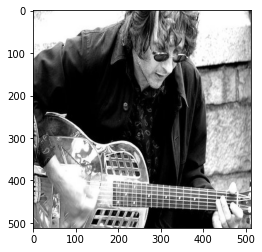

Visualizzazione dell'immagine criptata



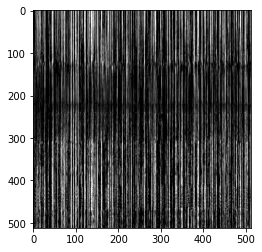

Visualizzazione dell'immagine decompressa e decriptata



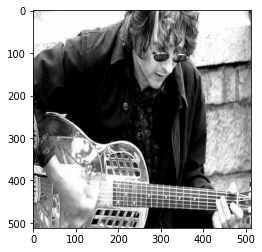

Compressione Rate (size img iniziale/ size img compressa compressa): 10.21
PSNR ETC value is 29.96 dB
PSNR STD value is 31.47 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



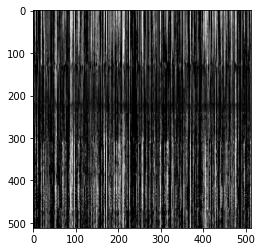


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



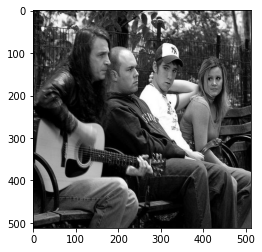

Visualizzazione dell'immagine criptata



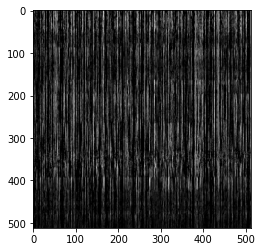

Visualizzazione dell'immagine decompressa e decriptata



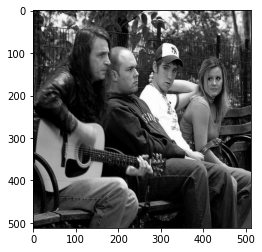

Compressione Rate (size img iniziale/ size img compressa compressa): 12.35
PSNR ETC value is 29.98 dB
PSNR STD value is 30.97 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



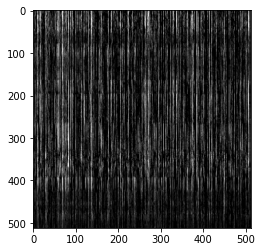


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



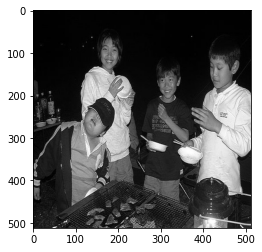

Visualizzazione dell'immagine criptata



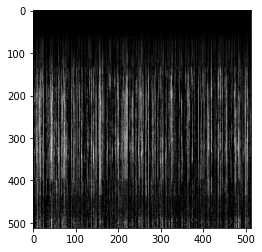

Visualizzazione dell'immagine decompressa e decriptata



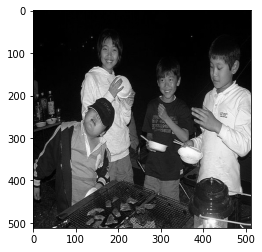

Compressione Rate (size img iniziale/ size img compressa compressa): 13.58
PSNR ETC value is 30.43 dB
PSNR STD value is 31.54 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



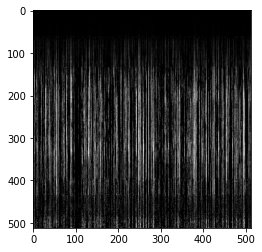


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



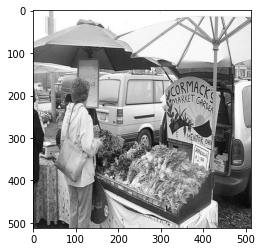

Visualizzazione dell'immagine criptata



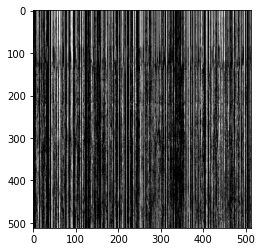

Visualizzazione dell'immagine decompressa e decriptata



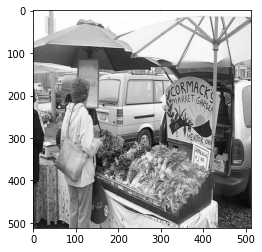

Compressione Rate (size img iniziale/ size img compressa compressa): 10.02
PSNR ETC value is 30.01 dB
PSNR STD value is 30.29 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



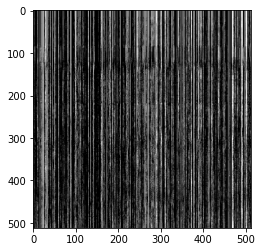


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



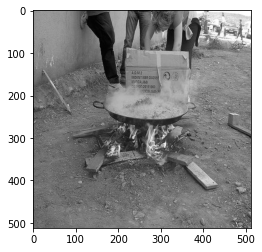

Visualizzazione dell'immagine criptata



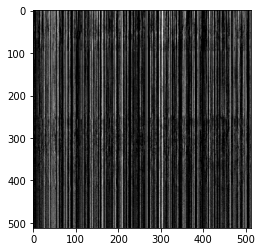

Visualizzazione dell'immagine decompressa e decriptata



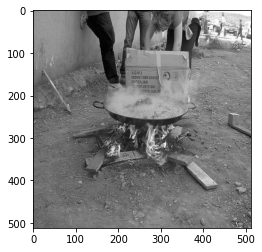

Compressione Rate (size img iniziale/ size img compressa compressa): 11.86
PSNR ETC value is 29.99 dB
PSNR STD value is 30.09 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



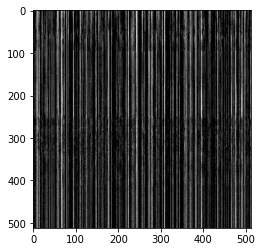

Qualità dell'immagine 30%

*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



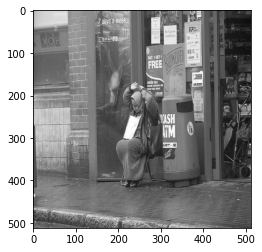

Visualizzazione dell'immagine criptata



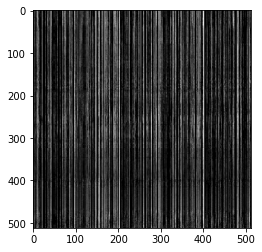

Visualizzazione dell'immagine decompressa e decriptata



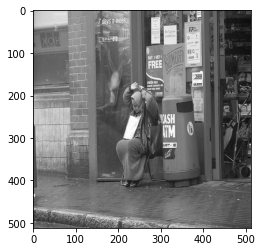

Compressione Rate (size img iniziale/ size img compressa compressa): 5.98
PSNR ETC value is 31.76 dB
PSNR STD value is 32.73 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



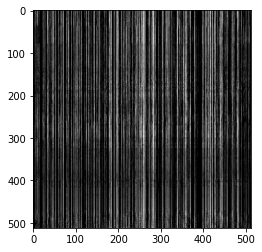


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



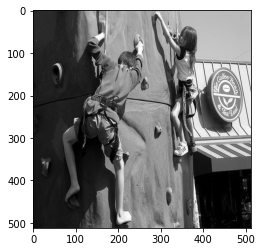

Visualizzazione dell'immagine criptata



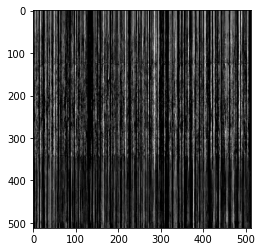

Visualizzazione dell'immagine decompressa e decriptata



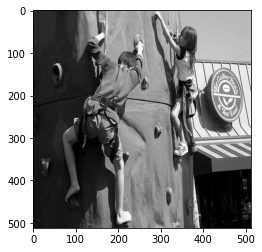

Compressione Rate (size img iniziale/ size img compressa compressa): 5.78
PSNR ETC value is 31.68 dB
PSNR STD value is 33.49 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



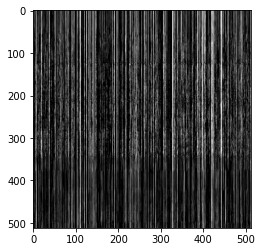


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



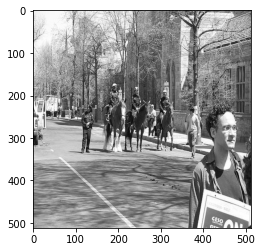

Visualizzazione dell'immagine criptata



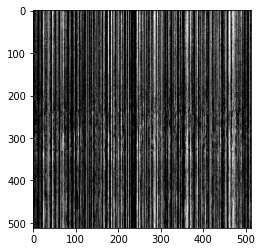

Visualizzazione dell'immagine decompressa e decriptata



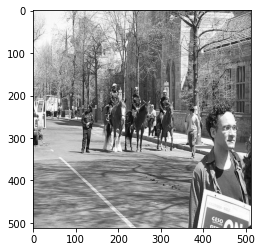

Compressione Rate (size img iniziale/ size img compressa compressa): 5.78
PSNR ETC value is 30.84 dB
PSNR STD value is 30.55 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



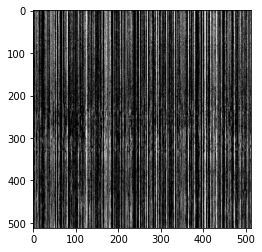


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



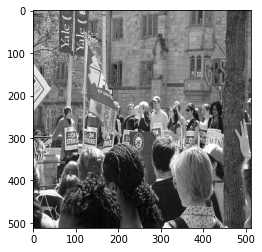

Visualizzazione dell'immagine criptata



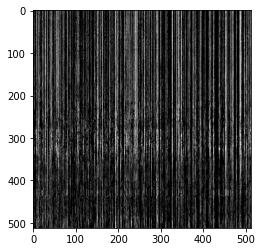

Visualizzazione dell'immagine decompressa e decriptata



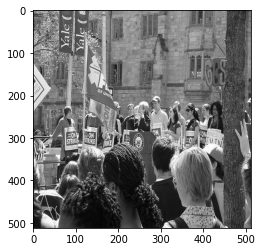

Compressione Rate (size img iniziale/ size img compressa compressa): 6.14
PSNR ETC value is 30.95 dB
PSNR STD value is 30.75 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



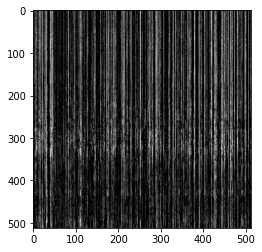


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



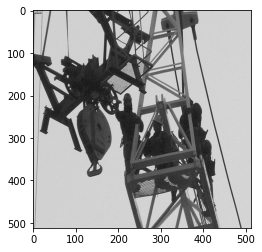

Visualizzazione dell'immagine criptata



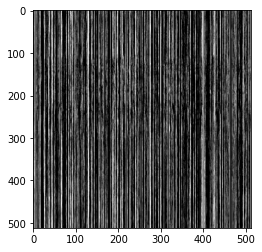

Visualizzazione dell'immagine decompressa e decriptata



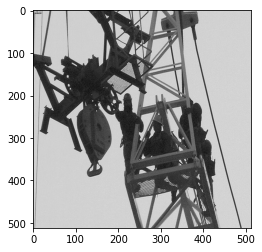

Compressione Rate (size img iniziale/ size img compressa compressa): 5.20
PSNR ETC value is 31.59 dB
PSNR STD value is 33.06 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



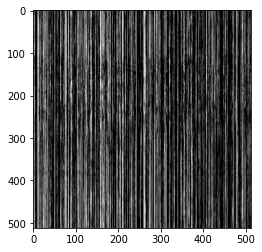


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



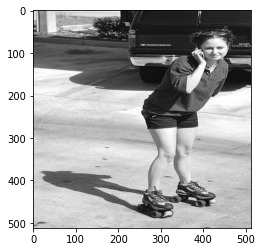

Visualizzazione dell'immagine criptata



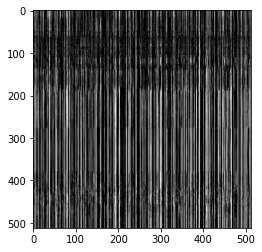

Visualizzazione dell'immagine decompressa e decriptata



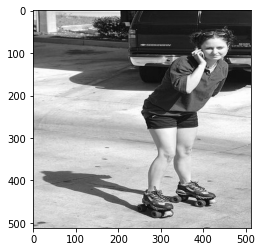

Compressione Rate (size img iniziale/ size img compressa compressa): 5.68
PSNR ETC value is 31.66 dB
PSNR STD value is 33.63 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



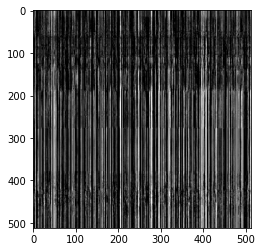


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



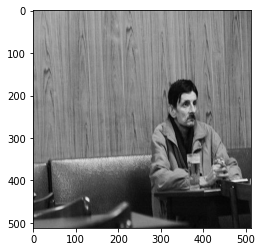

Visualizzazione dell'immagine criptata



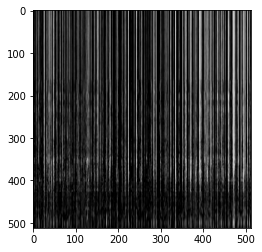

Visualizzazione dell'immagine decompressa e decriptata



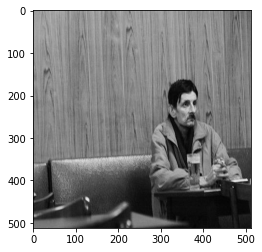

Compressione Rate (size img iniziale/ size img compressa compressa): 5.10
PSNR ETC value is 32.92 dB
PSNR STD value is 34.72 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



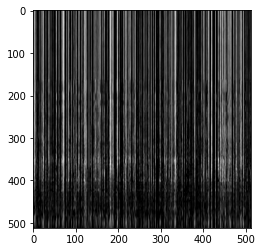


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



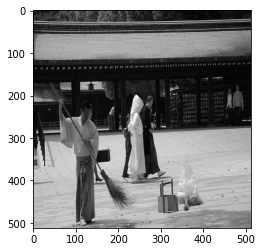

Visualizzazione dell'immagine criptata



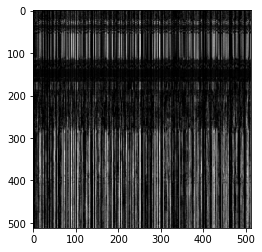

Visualizzazione dell'immagine decompressa e decriptata



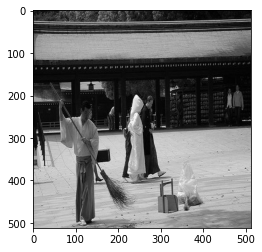

Compressione Rate (size img iniziale/ size img compressa compressa): 6.26
PSNR ETC value is 31.60 dB
PSNR STD value is 32.84 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



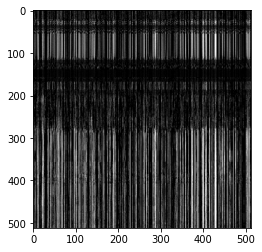


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



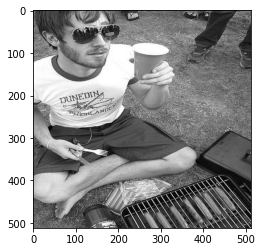

Visualizzazione dell'immagine criptata



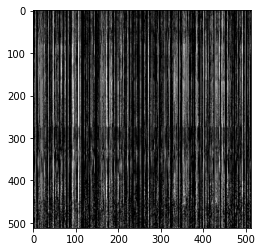

Visualizzazione dell'immagine decompressa e decriptata



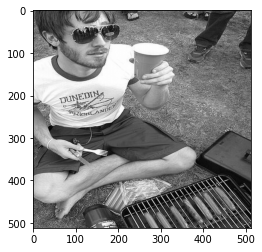

Compressione Rate (size img iniziale/ size img compressa compressa): 6.04
PSNR ETC value is 30.98 dB
PSNR STD value is 31.13 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



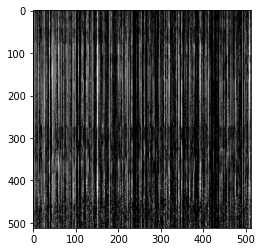


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



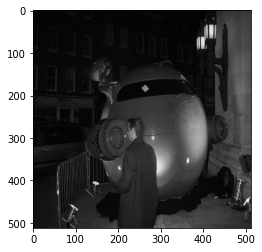

Visualizzazione dell'immagine criptata



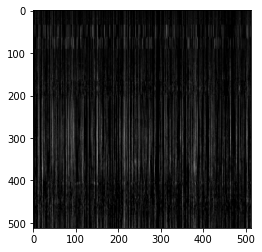

Visualizzazione dell'immagine decompressa e decriptata



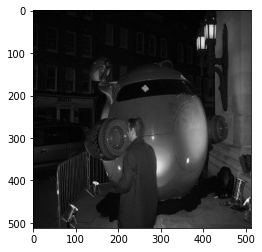

Compressione Rate (size img iniziale/ size img compressa compressa): 7.38
PSNR ETC value is 32.91 dB
PSNR STD value is 36.80 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



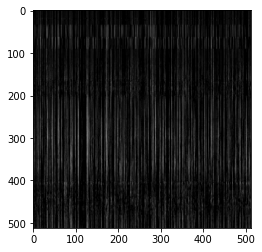


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



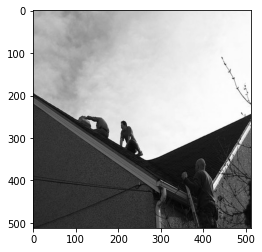

Visualizzazione dell'immagine criptata



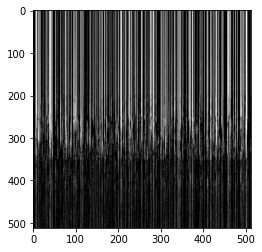

Visualizzazione dell'immagine decompressa e decriptata



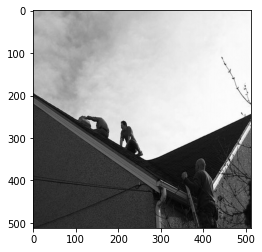

Compressione Rate (size img iniziale/ size img compressa compressa): 5.15
PSNR ETC value is 32.58 dB
PSNR STD value is 35.60 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



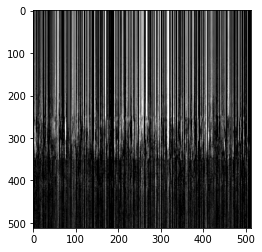


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



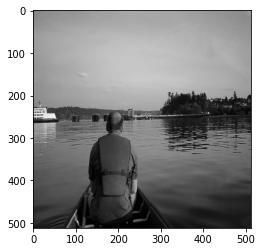

Visualizzazione dell'immagine criptata



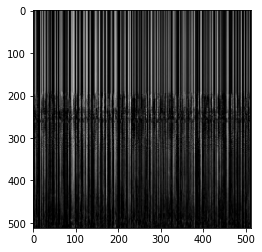

Visualizzazione dell'immagine decompressa e decriptata



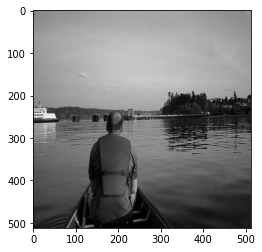

Compressione Rate (size img iniziale/ size img compressa compressa): 5.12
PSNR ETC value is 32.77 dB
PSNR STD value is 36.53 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



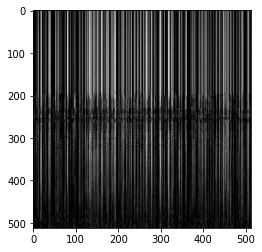


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



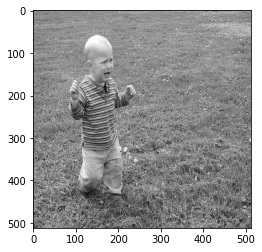

Visualizzazione dell'immagine criptata



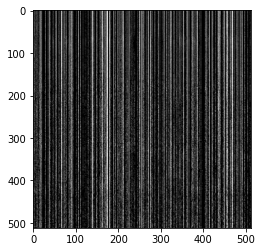

Visualizzazione dell'immagine decompressa e decriptata



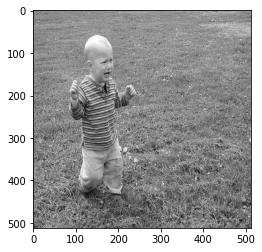

Compressione Rate (size img iniziale/ size img compressa compressa): 6.10
PSNR ETC value is 30.78 dB
PSNR STD value is 29.44 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



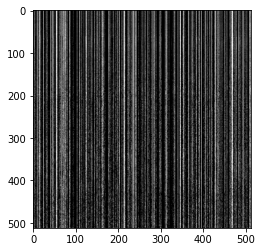


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



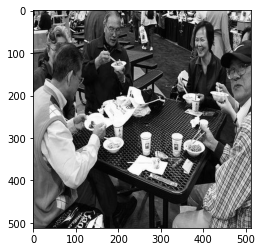

Visualizzazione dell'immagine criptata



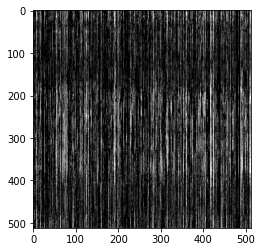

Visualizzazione dell'immagine decompressa e decriptata



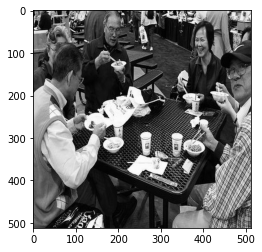

Compressione Rate (size img iniziale/ size img compressa compressa): 6.13
PSNR ETC value is 30.70 dB
PSNR STD value is 31.54 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



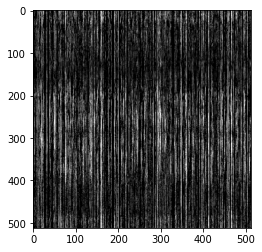


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



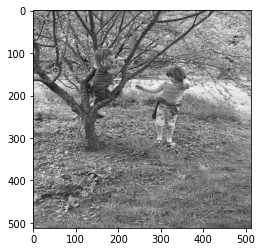

Visualizzazione dell'immagine criptata



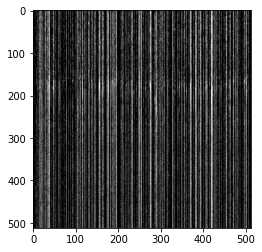

Visualizzazione dell'immagine decompressa e decriptata



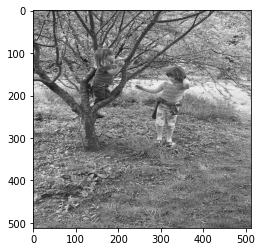

Compressione Rate (size img iniziale/ size img compressa compressa): 6.63
PSNR ETC value is 30.33 dB
PSNR STD value is 29.11 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



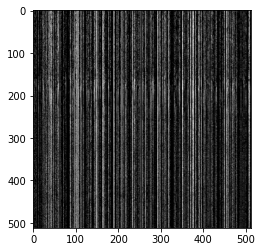


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



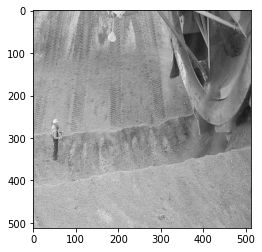

Visualizzazione dell'immagine criptata



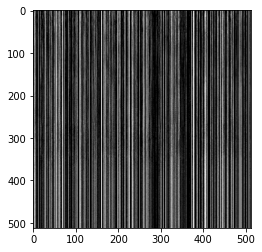

Visualizzazione dell'immagine decompressa e decriptata



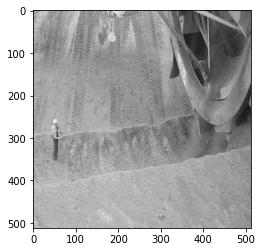

Compressione Rate (size img iniziale/ size img compressa compressa): 5.58
PSNR ETC value is 32.17 dB
PSNR STD value is 32.27 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



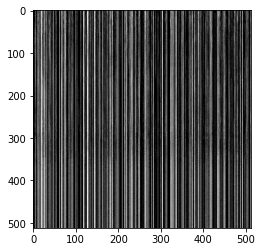


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



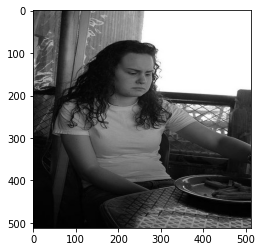

Visualizzazione dell'immagine criptata



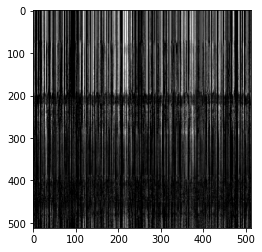

Visualizzazione dell'immagine decompressa e decriptata



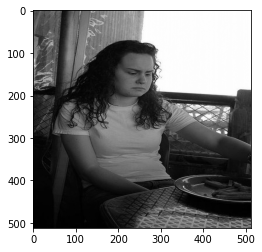

Compressione Rate (size img iniziale/ size img compressa compressa): 6.61
PSNR ETC value is 31.77 dB
PSNR STD value is 34.63 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



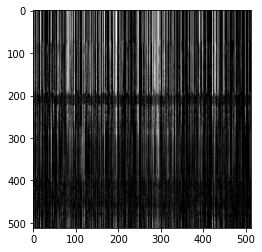


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



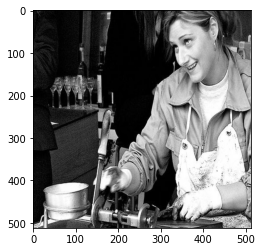

Visualizzazione dell'immagine criptata



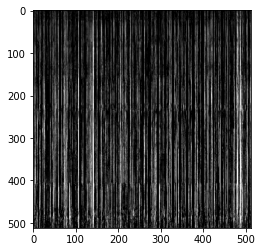

Visualizzazione dell'immagine decompressa e decriptata



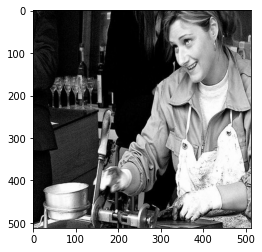

Compressione Rate (size img iniziale/ size img compressa compressa): 5.68
PSNR ETC value is 31.61 dB
PSNR STD value is 32.67 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



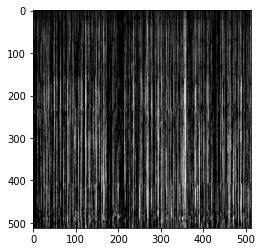


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



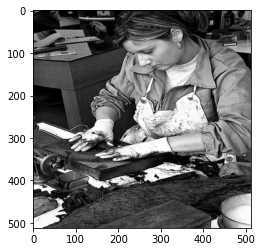

Visualizzazione dell'immagine criptata



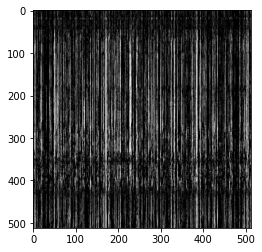

Visualizzazione dell'immagine decompressa e decriptata



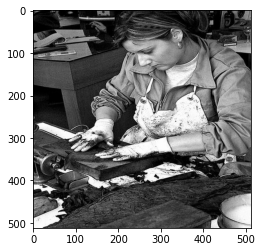

Compressione Rate (size img iniziale/ size img compressa compressa): 6.35
PSNR ETC value is 30.77 dB
PSNR STD value is 31.27 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



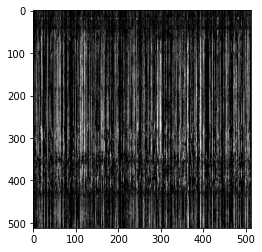


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



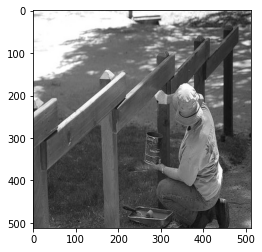

Visualizzazione dell'immagine criptata



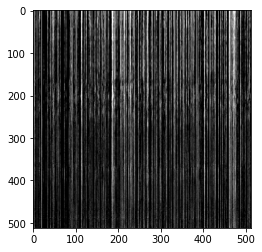

Visualizzazione dell'immagine decompressa e decriptata



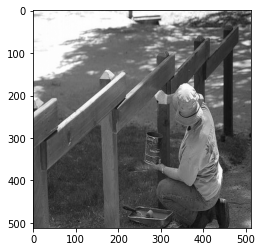

Compressione Rate (size img iniziale/ size img compressa compressa): 5.83
PSNR ETC value is 31.89 dB
PSNR STD value is 34.30 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



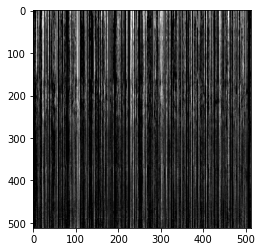


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



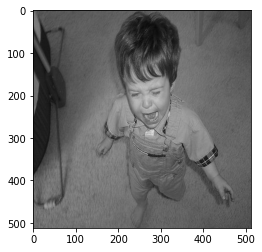

Visualizzazione dell'immagine criptata



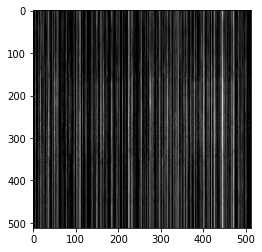

Visualizzazione dell'immagine decompressa e decriptata



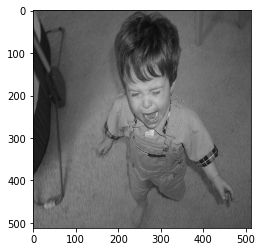

Compressione Rate (size img iniziale/ size img compressa compressa): 5.78
PSNR ETC value is 33.03 dB
PSNR STD value is 35.47 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



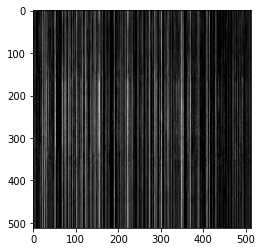


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



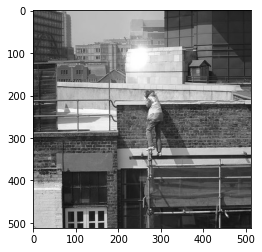

Visualizzazione dell'immagine criptata



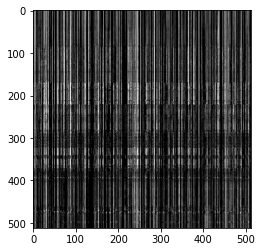

Visualizzazione dell'immagine decompressa e decriptata



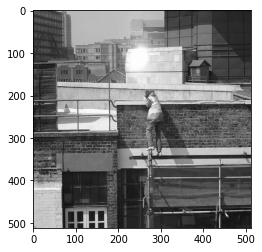

Compressione Rate (size img iniziale/ size img compressa compressa): 5.99
PSNR ETC value is 31.44 dB
PSNR STD value is 32.75 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



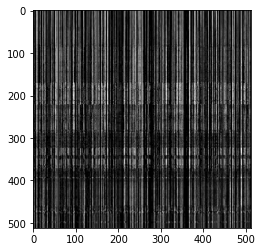


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



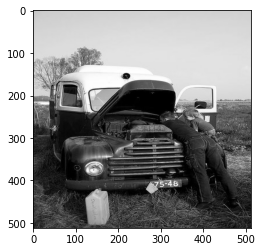

Visualizzazione dell'immagine criptata



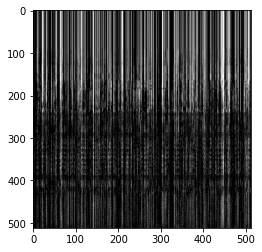

Visualizzazione dell'immagine decompressa e decriptata



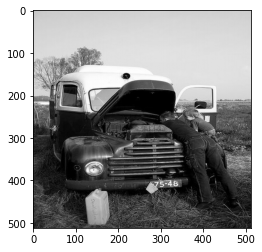

Compressione Rate (size img iniziale/ size img compressa compressa): 6.10
PSNR ETC value is 31.45 dB
PSNR STD value is 32.69 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



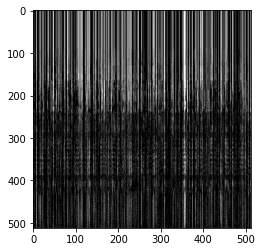


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



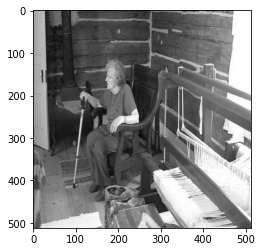

Visualizzazione dell'immagine criptata



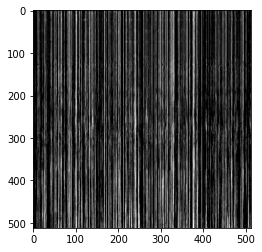

Visualizzazione dell'immagine decompressa e decriptata



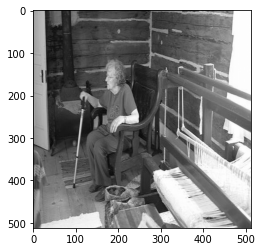

Compressione Rate (size img iniziale/ size img compressa compressa): 5.47
PSNR ETC value is 31.98 dB
PSNR STD value is 34.84 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



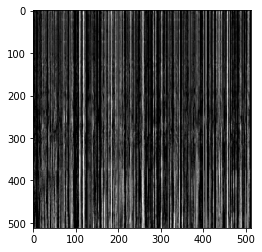


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



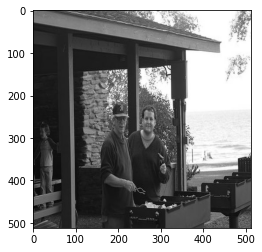

Visualizzazione dell'immagine criptata



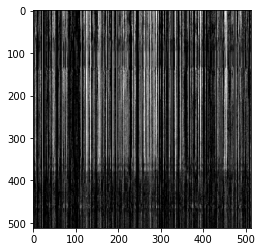

Visualizzazione dell'immagine decompressa e decriptata



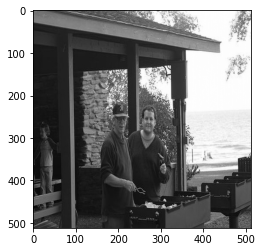

Compressione Rate (size img iniziale/ size img compressa compressa): 5.95
PSNR ETC value is 31.54 dB
PSNR STD value is 34.05 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



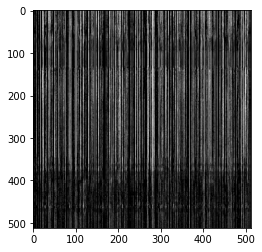


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



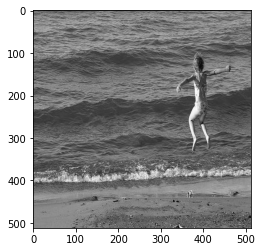

Visualizzazione dell'immagine criptata



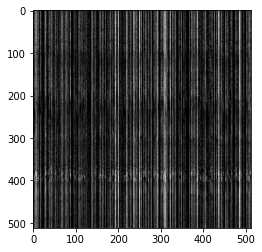

Visualizzazione dell'immagine decompressa e decriptata



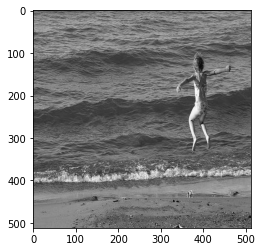

Compressione Rate (size img iniziale/ size img compressa compressa): 6.28
PSNR ETC value is 31.17 dB
PSNR STD value is 32.07 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



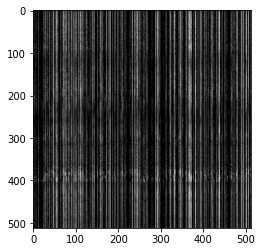


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



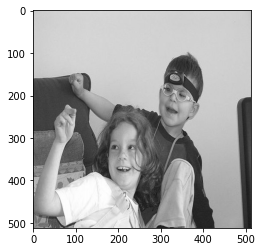

Visualizzazione dell'immagine criptata



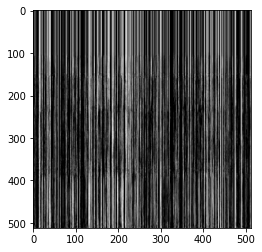

Visualizzazione dell'immagine decompressa e decriptata



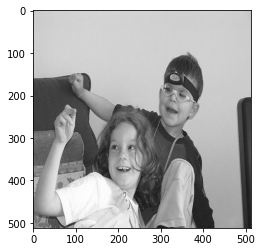

Compressione Rate (size img iniziale/ size img compressa compressa): 4.85
PSNR ETC value is 32.60 dB
PSNR STD value is 35.67 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



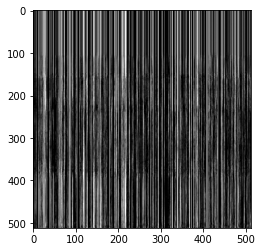


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



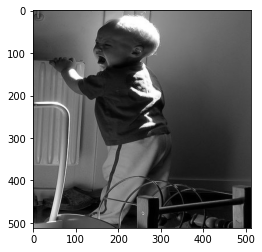

Visualizzazione dell'immagine criptata



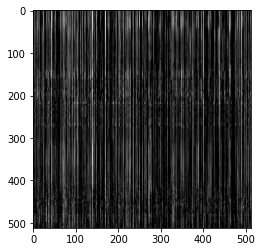

Visualizzazione dell'immagine decompressa e decriptata



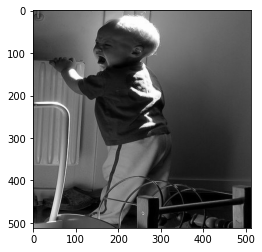

Compressione Rate (size img iniziale/ size img compressa compressa): 6.20
PSNR ETC value is 32.19 dB
PSNR STD value is 36.42 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



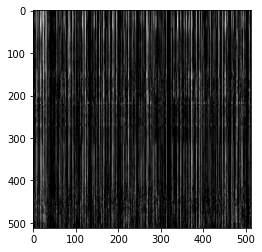


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



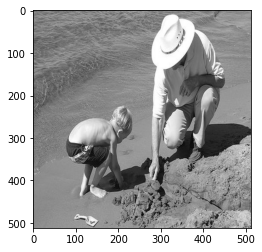

Visualizzazione dell'immagine criptata



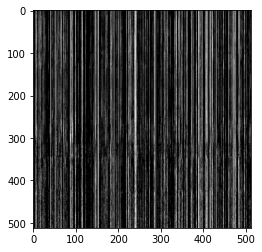

Visualizzazione dell'immagine decompressa e decriptata



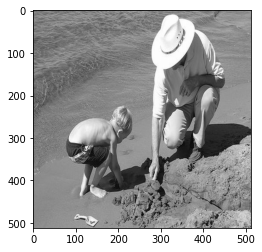

Compressione Rate (size img iniziale/ size img compressa compressa): 5.47
PSNR ETC value is 31.86 dB
PSNR STD value is 32.67 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



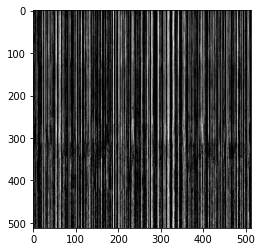


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



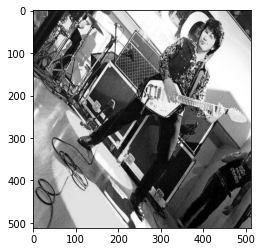

Visualizzazione dell'immagine criptata



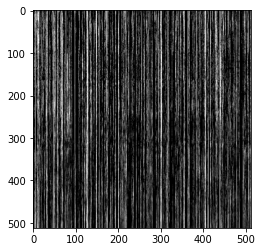

Visualizzazione dell'immagine decompressa e decriptata



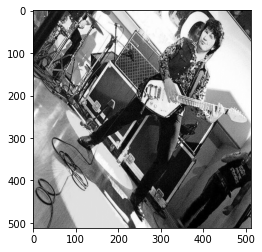

Compressione Rate (size img iniziale/ size img compressa compressa): 5.38
PSNR ETC value is 31.21 dB
PSNR STD value is 31.57 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



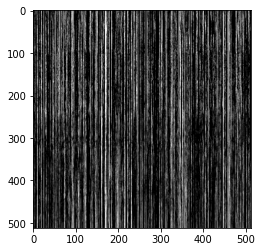


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



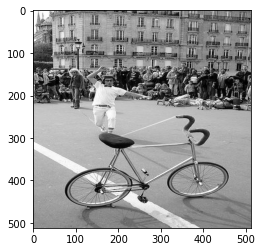

Visualizzazione dell'immagine criptata



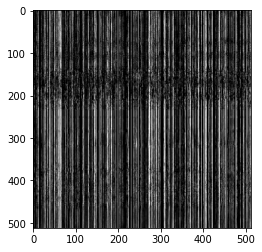

Visualizzazione dell'immagine decompressa e decriptata



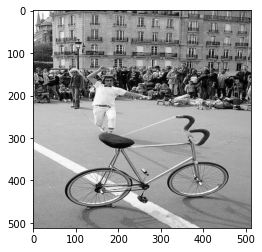

Compressione Rate (size img iniziale/ size img compressa compressa): 5.97
PSNR ETC value is 31.04 dB
PSNR STD value is 31.75 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



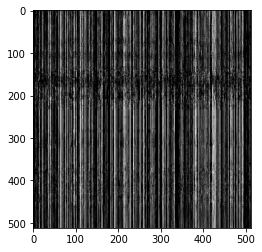


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



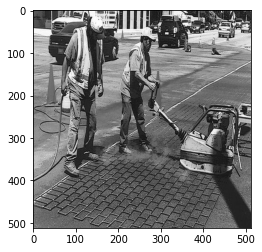

Visualizzazione dell'immagine criptata



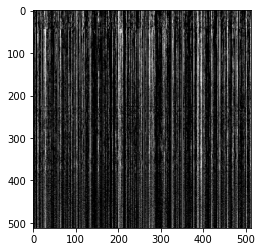

Visualizzazione dell'immagine decompressa e decriptata



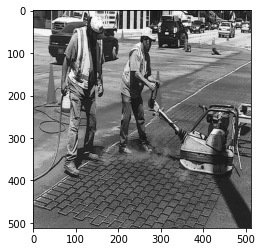

Compressione Rate (size img iniziale/ size img compressa compressa): 6.11
PSNR ETC value is 30.72 dB
PSNR STD value is 30.51 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



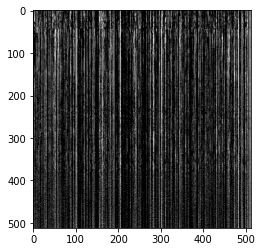


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



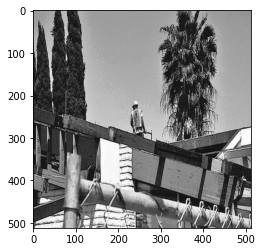

Visualizzazione dell'immagine criptata



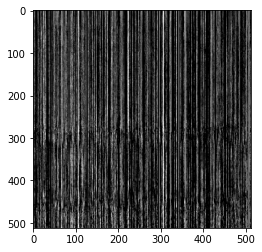

Visualizzazione dell'immagine decompressa e decriptata



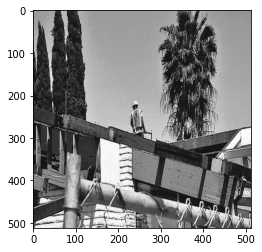

Compressione Rate (size img iniziale/ size img compressa compressa): 5.65
PSNR ETC value is 31.15 dB
PSNR STD value is 31.95 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



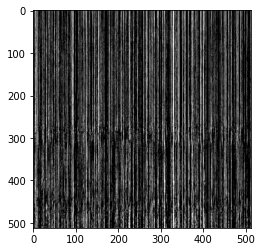


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



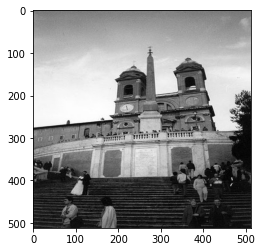

Visualizzazione dell'immagine criptata



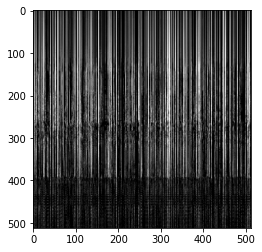

Visualizzazione dell'immagine decompressa e decriptata



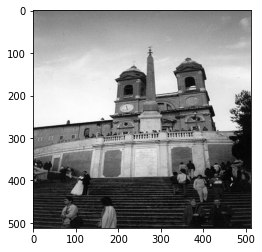

Compressione Rate (size img iniziale/ size img compressa compressa): 5.98
PSNR ETC value is 31.66 dB
PSNR STD value is 33.85 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



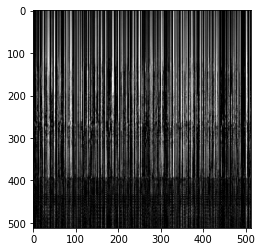


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



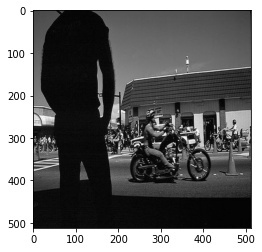

Visualizzazione dell'immagine criptata



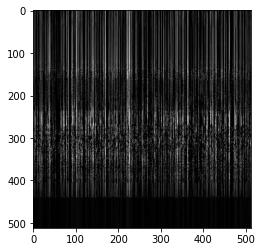

Visualizzazione dell'immagine decompressa e decriptata



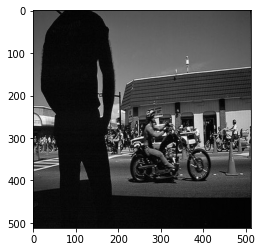

Compressione Rate (size img iniziale/ size img compressa compressa): 6.58
PSNR ETC value is 32.11 dB
PSNR STD value is 34.60 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



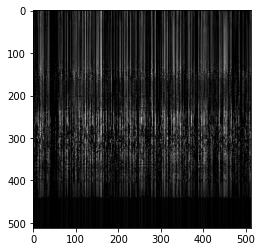


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



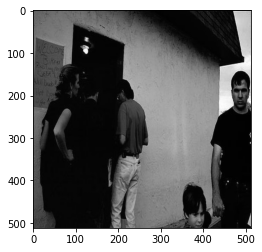

Visualizzazione dell'immagine criptata



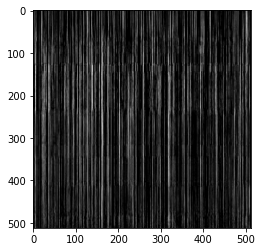

Visualizzazione dell'immagine decompressa e decriptata



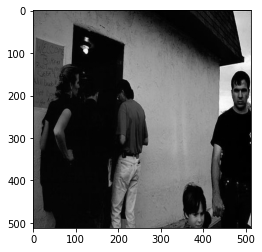

Compressione Rate (size img iniziale/ size img compressa compressa): 5.69
PSNR ETC value is 32.68 dB
PSNR STD value is 36.48 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



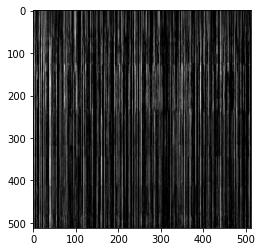


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



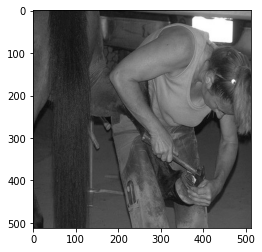

Visualizzazione dell'immagine criptata



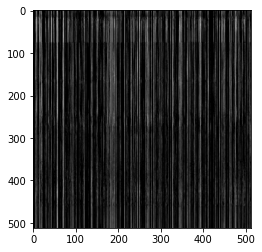

Visualizzazione dell'immagine decompressa e decriptata



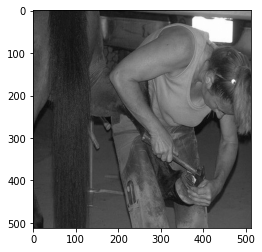

Compressione Rate (size img iniziale/ size img compressa compressa): 6.04
PSNR ETC value is 32.97 dB
PSNR STD value is 35.01 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



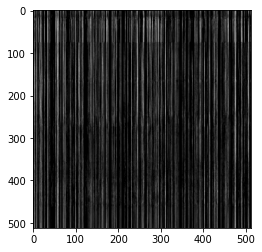


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



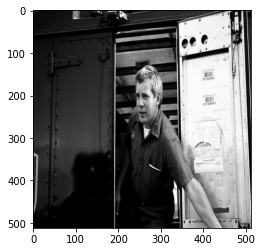

Visualizzazione dell'immagine criptata



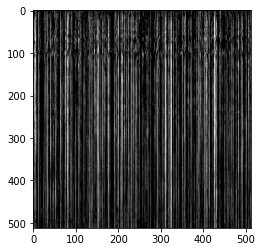

Visualizzazione dell'immagine decompressa e decriptata



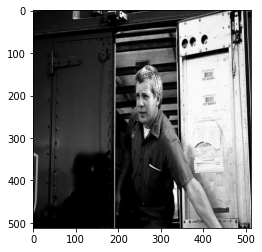

Compressione Rate (size img iniziale/ size img compressa compressa): 5.57
PSNR ETC value is 31.99 dB
PSNR STD value is 34.86 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



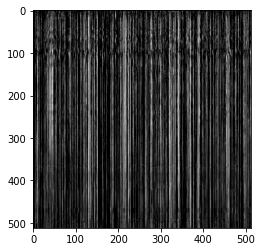


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



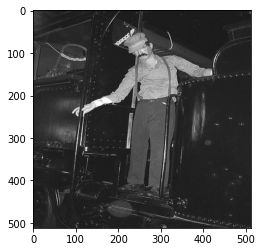

Visualizzazione dell'immagine criptata



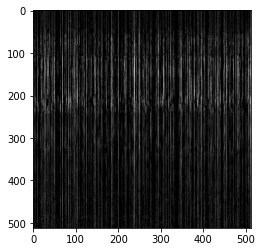

Visualizzazione dell'immagine decompressa e decriptata



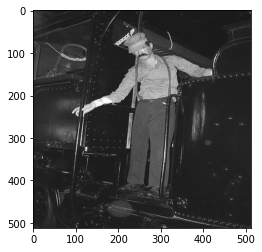

Compressione Rate (size img iniziale/ size img compressa compressa): 7.68
PSNR ETC value is 31.79 dB
PSNR STD value is 34.17 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



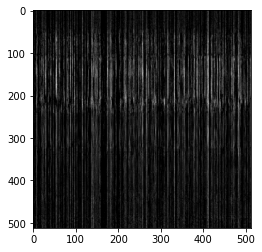


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



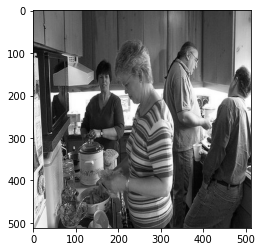

Visualizzazione dell'immagine criptata



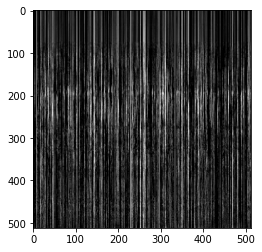

Visualizzazione dell'immagine decompressa e decriptata



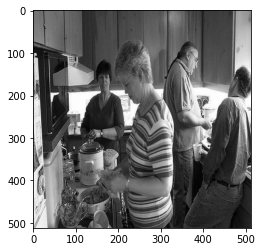

Compressione Rate (size img iniziale/ size img compressa compressa): 5.74
PSNR ETC value is 31.68 dB
PSNR STD value is 32.81 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



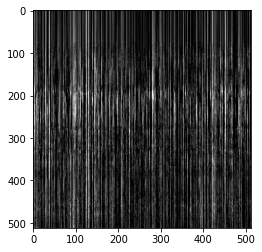


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



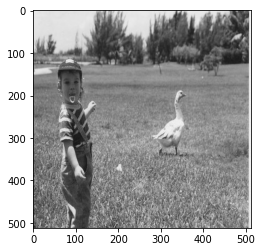

Visualizzazione dell'immagine criptata



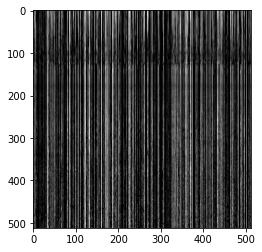

Visualizzazione dell'immagine decompressa e decriptata



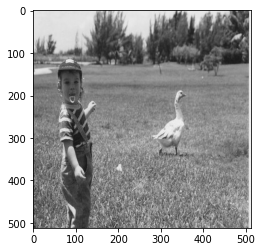

Compressione Rate (size img iniziale/ size img compressa compressa): 5.33
PSNR ETC value is 32.07 dB
PSNR STD value is 32.77 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



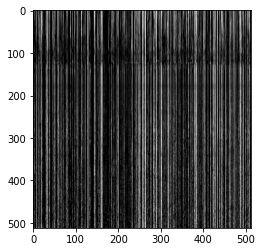


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



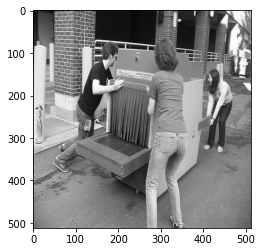

Visualizzazione dell'immagine criptata



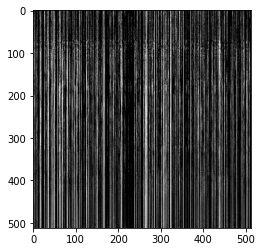

Visualizzazione dell'immagine decompressa e decriptata



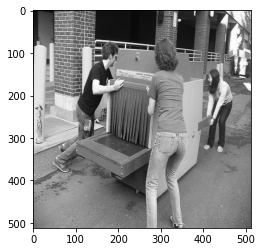

Compressione Rate (size img iniziale/ size img compressa compressa): 5.85
PSNR ETC value is 31.49 dB
PSNR STD value is 32.26 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



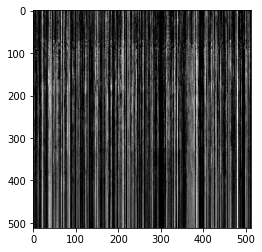


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



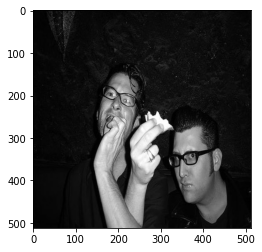

Visualizzazione dell'immagine criptata



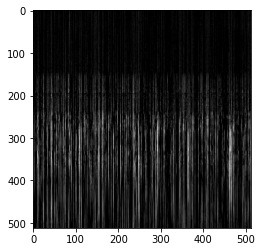

Visualizzazione dell'immagine decompressa e decriptata



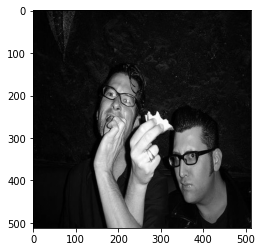

Compressione Rate (size img iniziale/ size img compressa compressa): 7.03
PSNR ETC value is 32.89 dB
PSNR STD value is 35.62 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



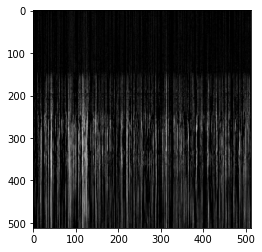


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



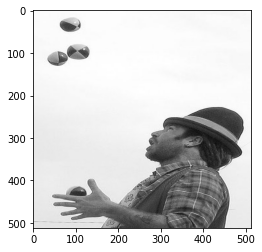

Visualizzazione dell'immagine criptata



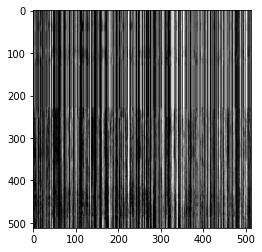

Visualizzazione dell'immagine decompressa e decriptata



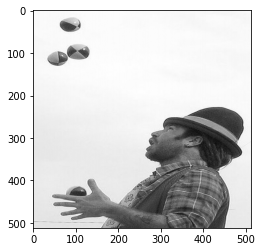

Compressione Rate (size img iniziale/ size img compressa compressa): 4.39
PSNR ETC value is 32.43 dB
PSNR STD value is 36.56 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



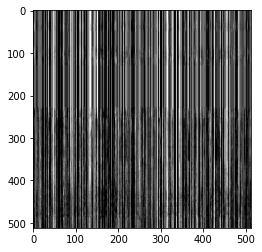


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



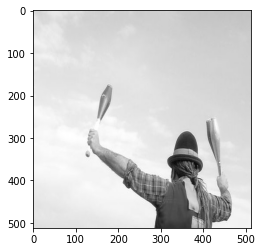

Visualizzazione dell'immagine criptata



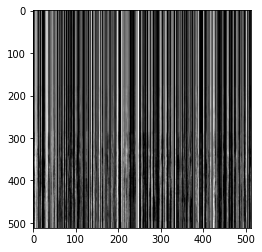

Visualizzazione dell'immagine decompressa e decriptata



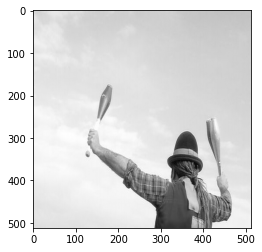

Compressione Rate (size img iniziale/ size img compressa compressa): 3.51
PSNR ETC value is 33.70 dB
PSNR STD value is 38.91 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



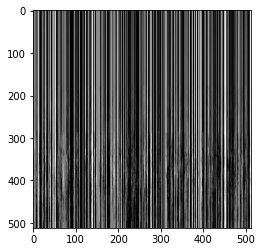


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



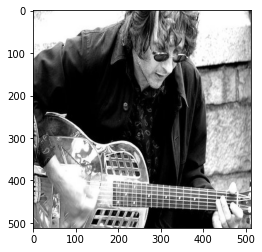

Visualizzazione dell'immagine criptata



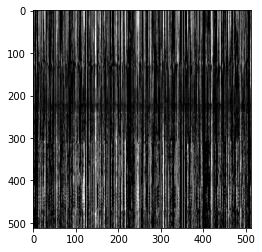

Visualizzazione dell'immagine decompressa e decriptata



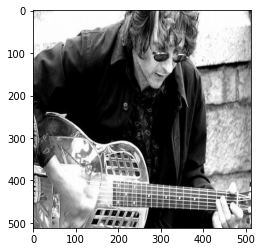

Compressione Rate (size img iniziale/ size img compressa compressa): 5.25
PSNR ETC value is 31.75 dB
PSNR STD value is 33.55 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



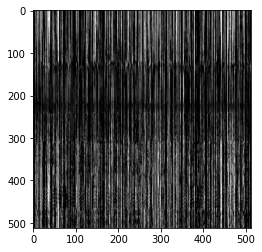


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



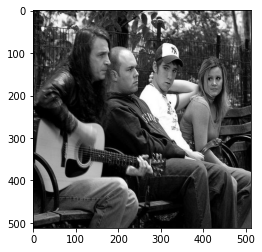

Visualizzazione dell'immagine criptata



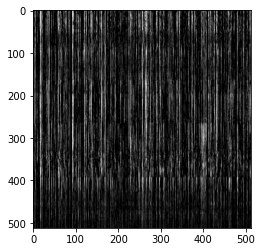

Visualizzazione dell'immagine decompressa e decriptata



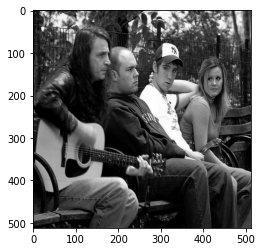

Compressione Rate (size img iniziale/ size img compressa compressa): 6.19
PSNR ETC value is 31.46 dB
PSNR STD value is 32.92 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



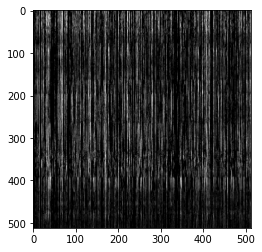


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



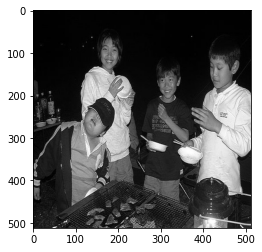

Visualizzazione dell'immagine criptata



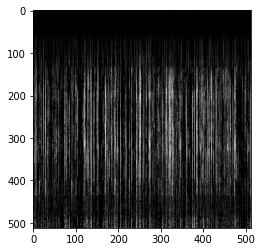

Visualizzazione dell'immagine decompressa e decriptata



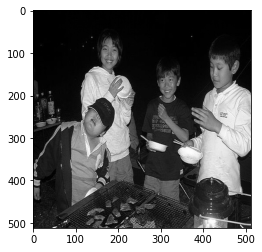

Compressione Rate (size img iniziale/ size img compressa compressa): 6.68
PSNR ETC value is 31.84 dB
PSNR STD value is 32.84 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



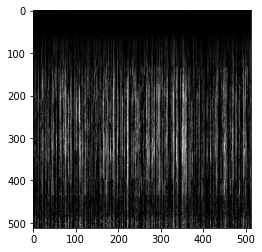


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



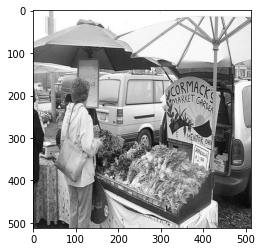

Visualizzazione dell'immagine criptata



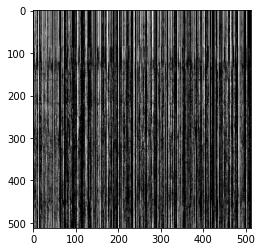

Visualizzazione dell'immagine decompressa e decriptata



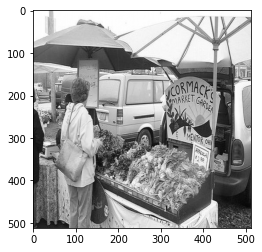

Compressione Rate (size img iniziale/ size img compressa compressa): 5.45
PSNR ETC value is 31.12 dB
PSNR STD value is 31.58 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



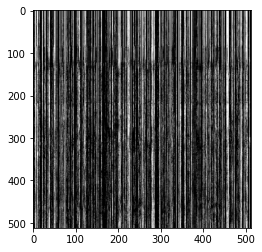


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



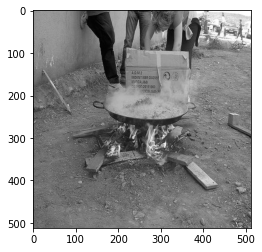

Visualizzazione dell'immagine criptata



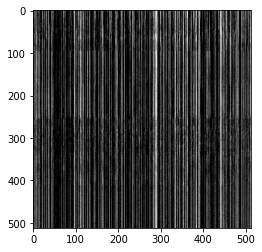

Visualizzazione dell'immagine decompressa e decriptata



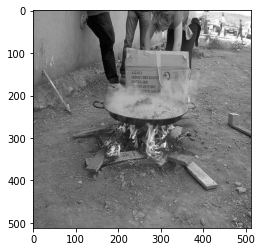

Compressione Rate (size img iniziale/ size img compressa compressa): 6.10
PSNR ETC value is 31.47 dB
PSNR STD value is 31.21 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



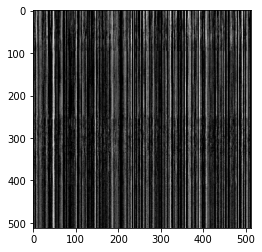

Qualità dell'immagine 50%

*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



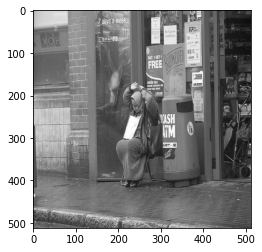

Visualizzazione dell'immagine criptata



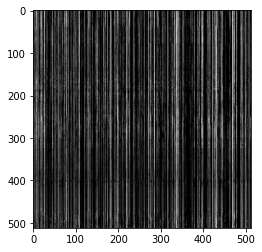

Visualizzazione dell'immagine decompressa e decriptata



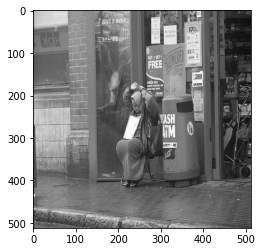

Compressione Rate (size img iniziale/ size img compressa compressa): 4.62
PSNR ETC value is 32.84 dB
PSNR STD value is 34.00 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



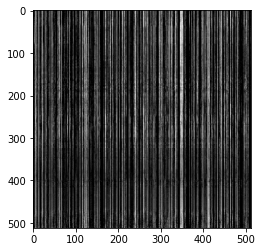


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



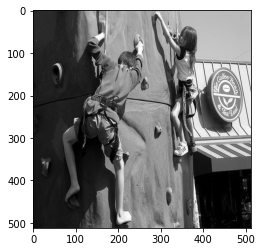

Visualizzazione dell'immagine criptata



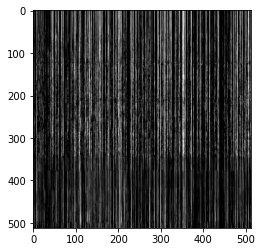

Visualizzazione dell'immagine decompressa e decriptata



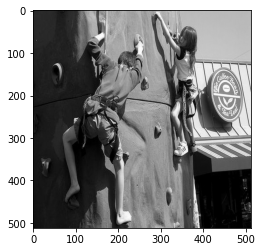

Compressione Rate (size img iniziale/ size img compressa compressa): 4.35
PSNR ETC value is 33.16 dB
PSNR STD value is 34.63 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



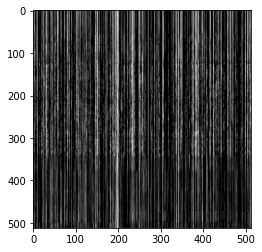


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



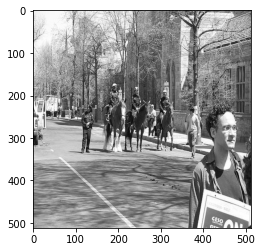

Visualizzazione dell'immagine criptata



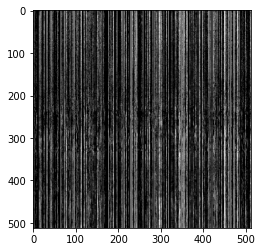

Visualizzazione dell'immagine decompressa e decriptata



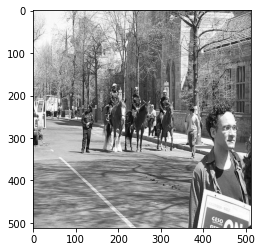

Compressione Rate (size img iniziale/ size img compressa compressa): 4.19
PSNR ETC value is 31.78 dB
PSNR STD value is 31.42 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



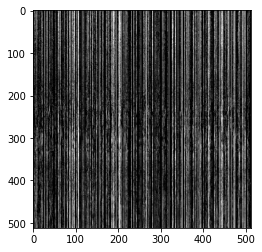


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



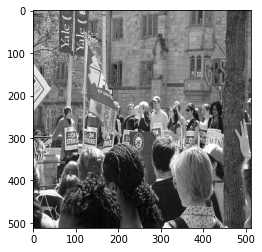

Visualizzazione dell'immagine criptata



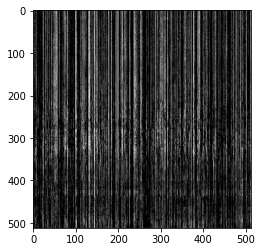

Visualizzazione dell'immagine decompressa e decriptata



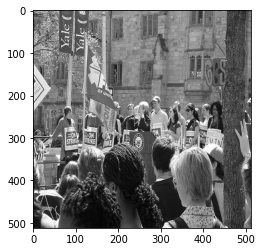

Compressione Rate (size img iniziale/ size img compressa compressa): 4.54
PSNR ETC value is 31.84 dB
PSNR STD value is 31.63 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



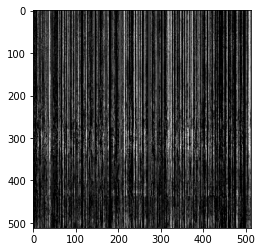


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



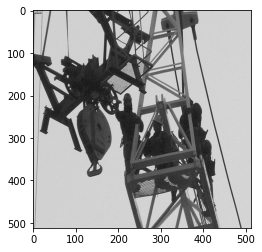

Visualizzazione dell'immagine criptata



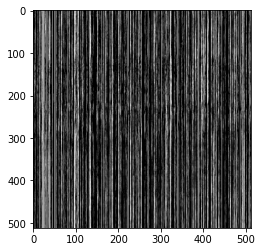

Visualizzazione dell'immagine decompressa e decriptata



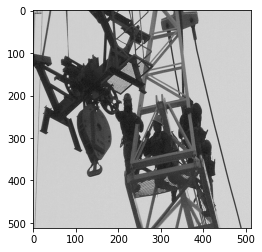

Compressione Rate (size img iniziale/ size img compressa compressa): 4.05
PSNR ETC value is 32.69 dB
PSNR STD value is 33.94 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



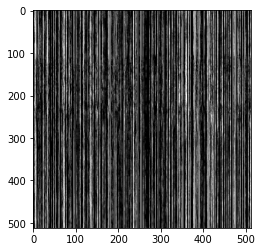


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



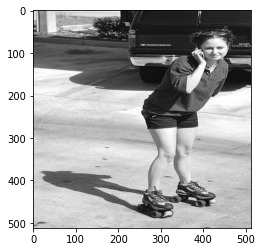

Visualizzazione dell'immagine criptata



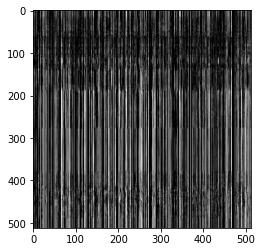

Visualizzazione dell'immagine decompressa e decriptata



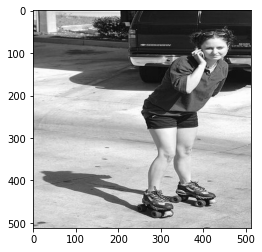

Compressione Rate (size img iniziale/ size img compressa compressa): 4.32
PSNR ETC value is 32.72 dB
PSNR STD value is 34.99 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



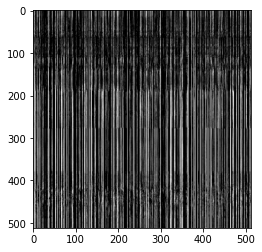


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



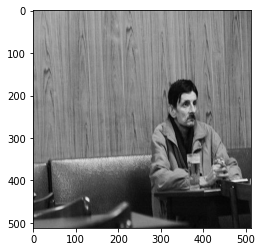

Visualizzazione dell'immagine criptata



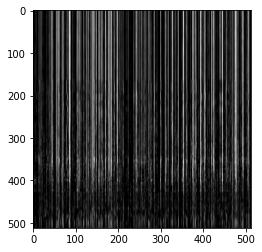

Visualizzazione dell'immagine decompressa e decriptata



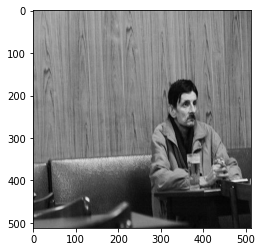

Compressione Rate (size img iniziale/ size img compressa compressa): 4.04
PSNR ETC value is 35.16 dB
PSNR STD value is 36.60 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



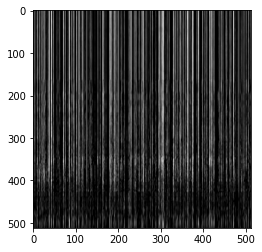


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



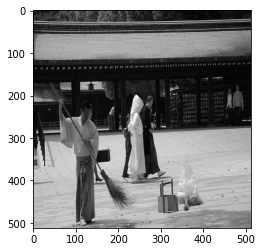

Visualizzazione dell'immagine criptata



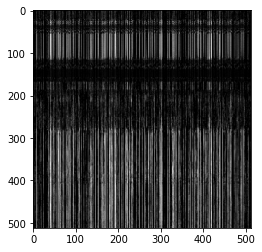

Visualizzazione dell'immagine decompressa e decriptata



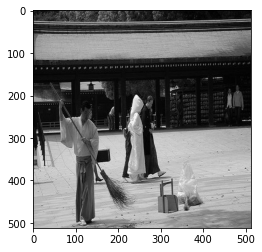

Compressione Rate (size img iniziale/ size img compressa compressa): 4.60
PSNR ETC value is 32.92 dB
PSNR STD value is 34.09 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



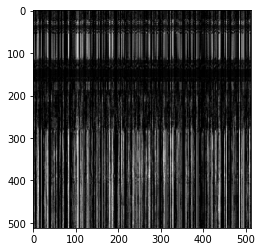


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



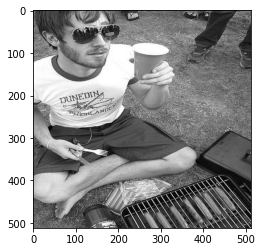

Visualizzazione dell'immagine criptata



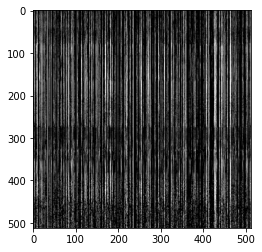

Visualizzazione dell'immagine decompressa e decriptata



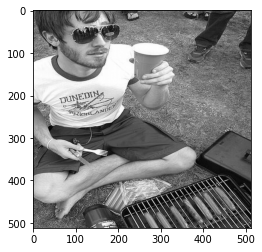

Compressione Rate (size img iniziale/ size img compressa compressa): 4.55
PSNR ETC value is 31.63 dB
PSNR STD value is 31.95 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



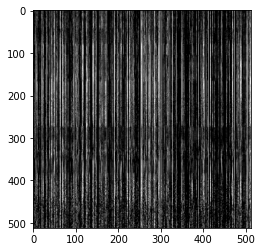


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



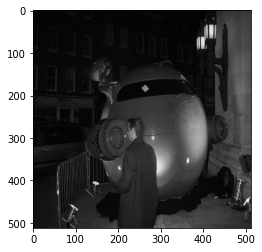

Visualizzazione dell'immagine criptata



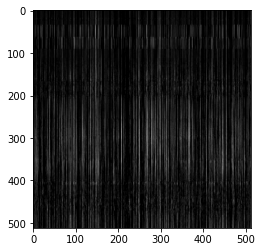

Visualizzazione dell'immagine decompressa e decriptata



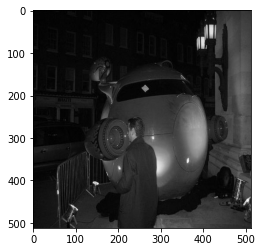

Compressione Rate (size img iniziale/ size img compressa compressa): 5.54
PSNR ETC value is 34.81 dB
PSNR STD value is 38.42 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



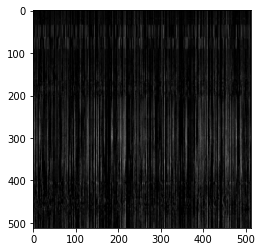


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



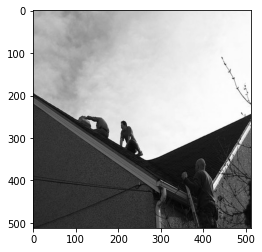

Visualizzazione dell'immagine criptata



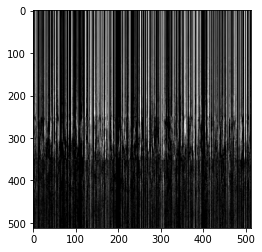

Visualizzazione dell'immagine decompressa e decriptata



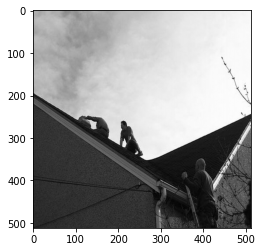

Compressione Rate (size img iniziale/ size img compressa compressa): 4.01
PSNR ETC value is 34.22 dB
PSNR STD value is 36.74 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



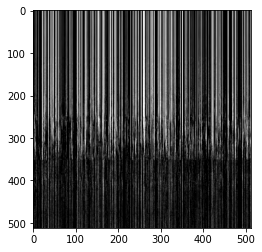


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



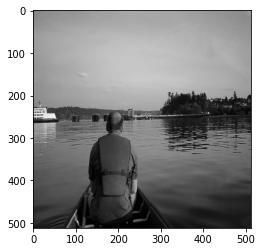

Visualizzazione dell'immagine criptata



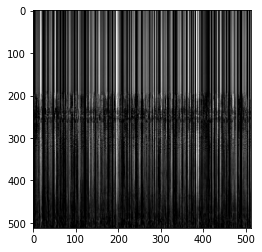

Visualizzazione dell'immagine decompressa e decriptata



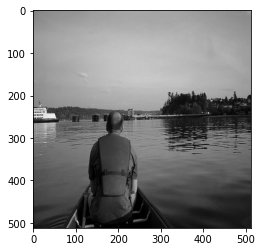

Compressione Rate (size img iniziale/ size img compressa compressa): 4.11
PSNR ETC value is 34.43 dB
PSNR STD value is 37.86 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



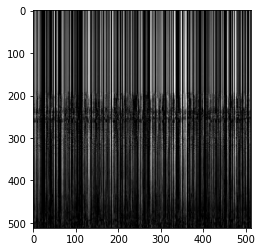


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



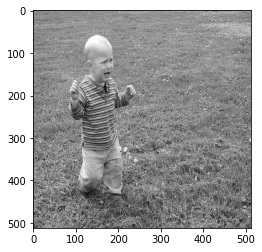

Visualizzazione dell'immagine criptata



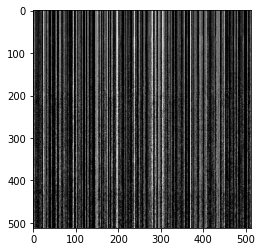

Visualizzazione dell'immagine decompressa e decriptata



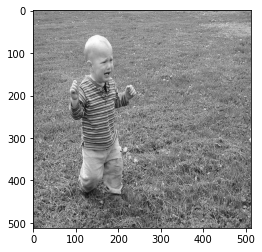

Compressione Rate (size img iniziale/ size img compressa compressa): 4.53
PSNR ETC value is 31.48 dB
PSNR STD value is 30.14 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



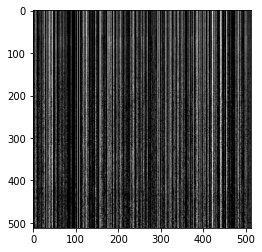


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



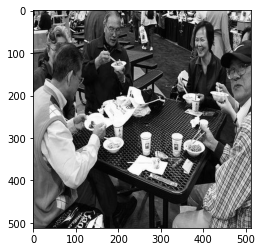

Visualizzazione dell'immagine criptata



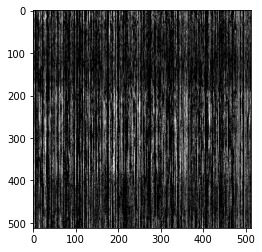

Visualizzazione dell'immagine decompressa e decriptata



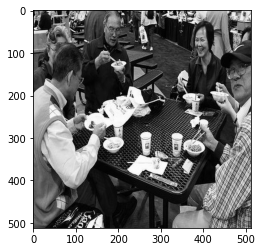

Compressione Rate (size img iniziale/ size img compressa compressa): 4.49
PSNR ETC value is 31.69 dB
PSNR STD value is 32.51 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



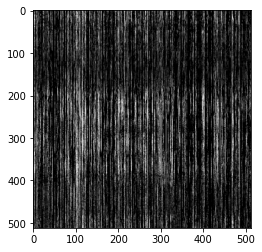


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



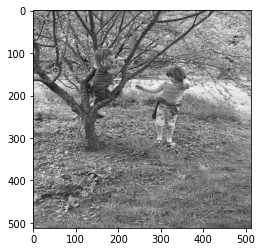

Visualizzazione dell'immagine criptata



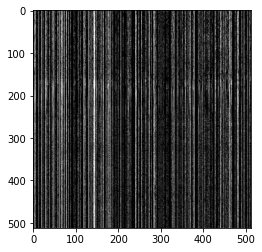

Visualizzazione dell'immagine decompressa e decriptata



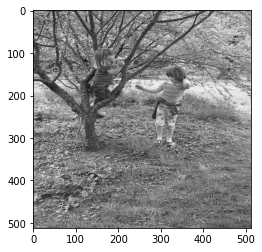

Compressione Rate (size img iniziale/ size img compressa compressa): 4.73
PSNR ETC value is 30.86 dB
PSNR STD value is 29.68 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



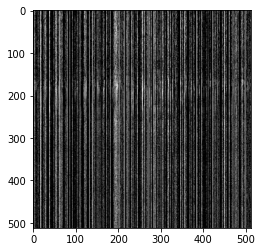


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



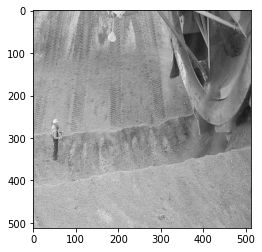

Visualizzazione dell'immagine criptata



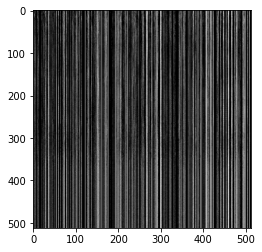

Visualizzazione dell'immagine decompressa e decriptata



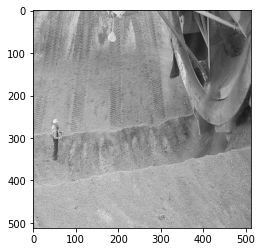

Compressione Rate (size img iniziale/ size img compressa compressa): 4.34
PSNR ETC value is 33.52 dB
PSNR STD value is 33.50 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



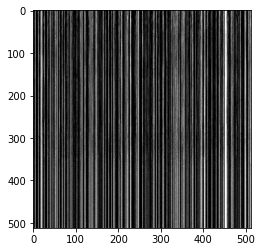


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



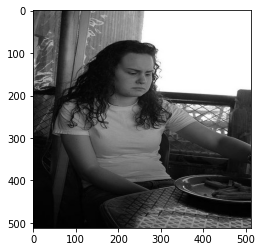

Visualizzazione dell'immagine criptata



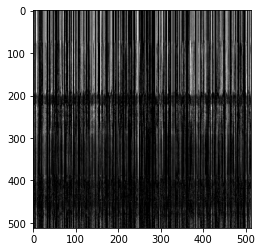

Visualizzazione dell'immagine decompressa e decriptata



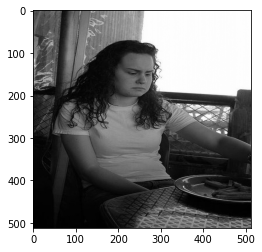

Compressione Rate (size img iniziale/ size img compressa compressa): 4.88
PSNR ETC value is 32.96 dB
PSNR STD value is 35.78 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



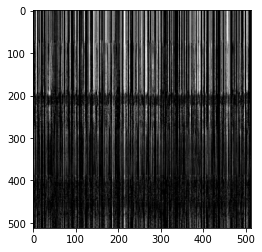


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



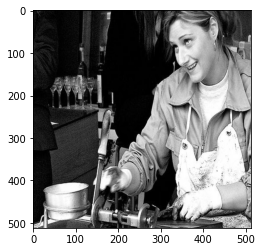

Visualizzazione dell'immagine criptata



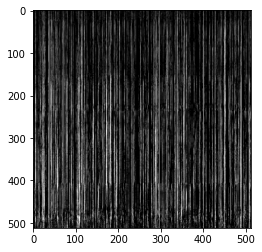

Visualizzazione dell'immagine decompressa e decriptata



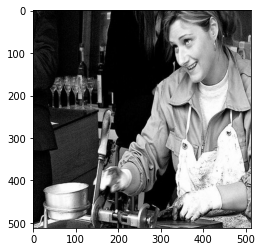

Compressione Rate (size img iniziale/ size img compressa compressa): 4.23
PSNR ETC value is 32.88 dB
PSNR STD value is 33.72 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



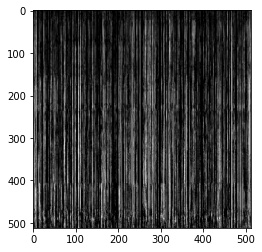


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



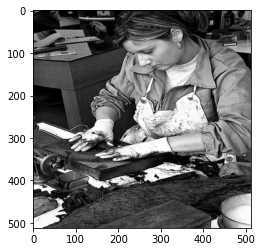

Visualizzazione dell'immagine criptata



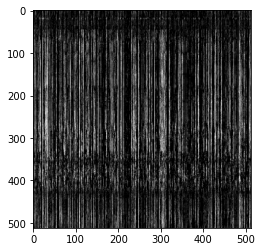

Visualizzazione dell'immagine decompressa e decriptata



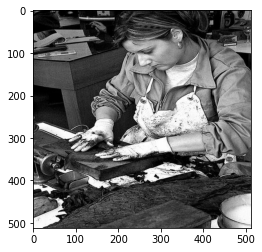

Compressione Rate (size img iniziale/ size img compressa compressa): 4.77
PSNR ETC value is 31.45 dB
PSNR STD value is 32.19 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



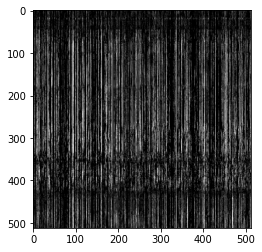


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



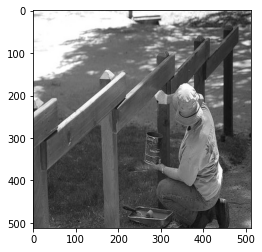

Visualizzazione dell'immagine criptata



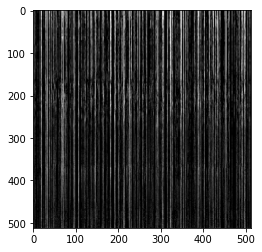

Visualizzazione dell'immagine decompressa e decriptata



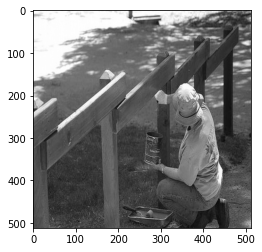

Compressione Rate (size img iniziale/ size img compressa compressa): 4.34
PSNR ETC value is 33.49 dB
PSNR STD value is 35.78 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



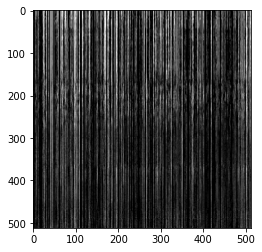


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



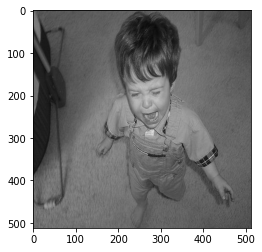

Visualizzazione dell'immagine criptata



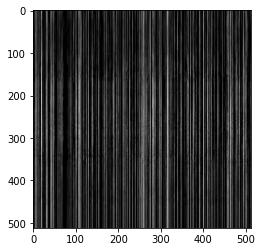

Visualizzazione dell'immagine decompressa e decriptata



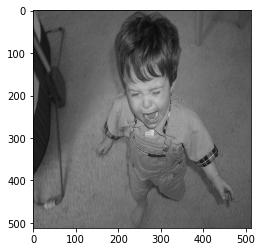

Compressione Rate (size img iniziale/ size img compressa compressa): 4.64
PSNR ETC value is 34.75 dB
PSNR STD value is 36.89 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



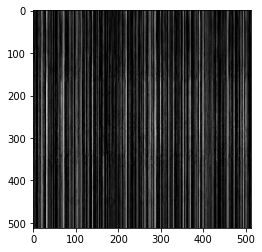


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



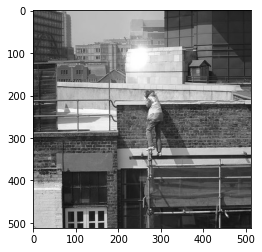

Visualizzazione dell'immagine criptata



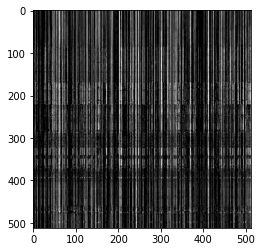

Visualizzazione dell'immagine decompressa e decriptata



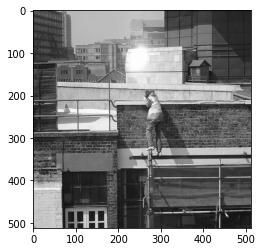

Compressione Rate (size img iniziale/ size img compressa compressa): 4.50
PSNR ETC value is 32.59 dB
PSNR STD value is 33.96 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



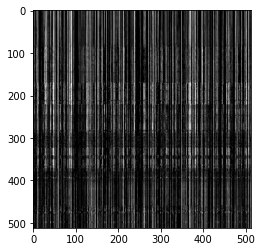


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



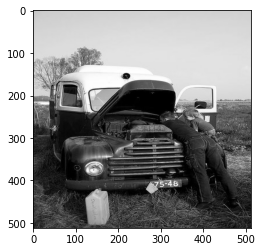

Visualizzazione dell'immagine criptata



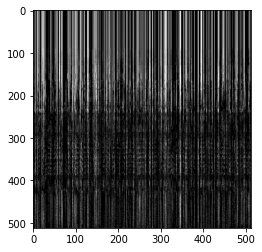

Visualizzazione dell'immagine decompressa e decriptata



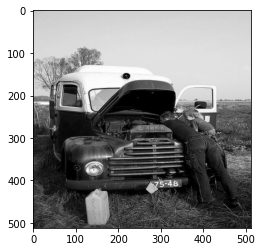

Compressione Rate (size img iniziale/ size img compressa compressa): 4.58
PSNR ETC value is 32.37 dB
PSNR STD value is 33.59 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



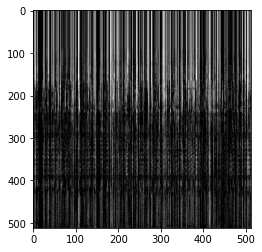


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



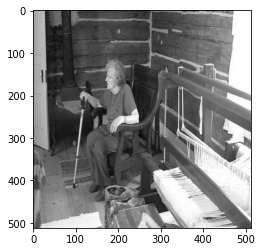

Visualizzazione dell'immagine criptata



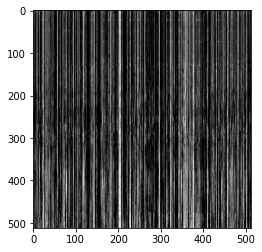

Visualizzazione dell'immagine decompressa e decriptata



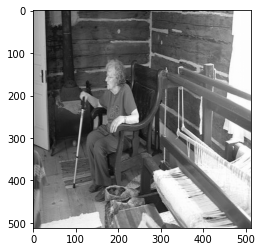

Compressione Rate (size img iniziale/ size img compressa compressa): 4.35
PSNR ETC value is 33.13 dB
PSNR STD value is 36.66 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



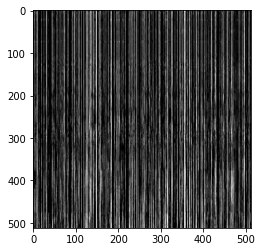


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



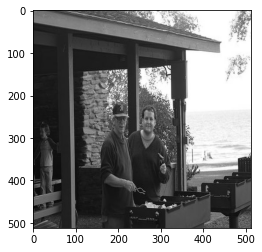

Visualizzazione dell'immagine criptata



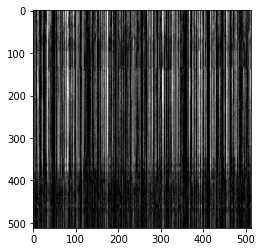

Visualizzazione dell'immagine decompressa e decriptata



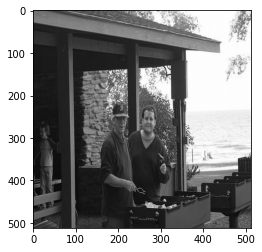

Compressione Rate (size img iniziale/ size img compressa compressa): 4.44
PSNR ETC value is 32.90 dB
PSNR STD value is 35.35 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



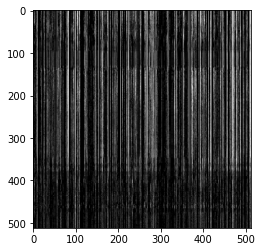


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



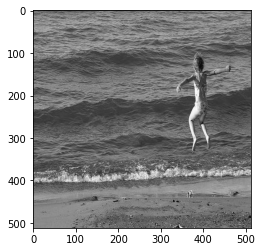

Visualizzazione dell'immagine criptata



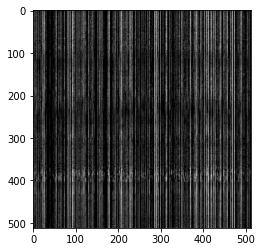

Visualizzazione dell'immagine decompressa e decriptata



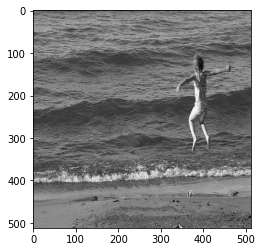

Compressione Rate (size img iniziale/ size img compressa compressa): 4.76
PSNR ETC value is 32.10 dB
PSNR STD value is 33.37 dB
Visualizzazione dell'immagine decompressa e decriptata dall'attaccante:



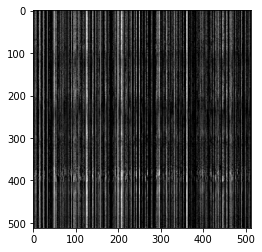


*---------------------------------------------------------------------*

(512, 512)
Visualizzazione dell'immagine originale



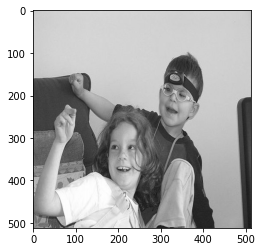

In [ ]:
image_list = {} # dizionario con chiave = nome immagine, valore = path dell'immagine

# Scorre i file nella cartella - non considera le sottocartelle
for filename in glob.glob(path_image+'*.*'):
  img = cv2.imread(filename) # Usa OpenCV per ottenere array numpy dall'immagine
  # Prende l'ultima occorrenza di '/' nel path per ottenere nome_immagine.ext
  image_name = filename[filename.rindex('/')+1:]
  image_list[image_name] = filename


qlt = [10, 30, 50, 70, 90]
for i in range( len(qlt)):
  lst_value = []
  print("Qualità dell'immagine "+ str(qlt[i])+"%")
  # Scorre la lista delle immagini per richiamare le funzioni dello schema Encrypt-Then-Compress
  for name_img, img_path in image_list.items():
    print("\n*---------------------------------------------------------------------*\n")
    img = cv2.imread(img_path)
    # Resize in quanto lavoriamo con immagini quadratiche 512x512
    img = cv2.resize(img, dsize=(512, 512), interpolation=cv2.INTER_LANCZOS4)

    # Conversione al modello YUV e scomposizione nelle 3 componenti
    yvu = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    y, v, u = cv2.split(yvu)
    ext = name_img[-4:]
    A,lst = etc(y, name_img[:-4]+"_qlt"+str(qlt[i])+ext, qlt[i])
    lst_value.append(lst)

    provaAttaccante(A)

  df = pd.DataFrame(lst_value, columns = ['Name','CR','PSNR-STD','PSNR-ETC'])
  df.to_csv('/content/drive/MyDrive/Progetto Compressione/Risultati CSV/risultati_qlt_'+str(qlt[i])+'.csv', encoding='utf-8')
